In [1]:
%matplotlib inline

In [2]:
import pulp
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

import pandas as pd
import numpy as np
from random import shuffle
from mpl_toolkits.mplot3d import Axes3D

In [3]:
# Hyper Parameters
LR = 0.2                   # learning rate
EPSILON = 0.7               # greedy policy
GAMMA = 0.9                 # reward discount
LAMBDA = 0.5                # parameter decay

N_ACTIONS = 10 #no. of duty cycles (0,1,2,3,...,10)
BMIN = 0.0
BMAX = 20000.0 #Battery capacity
BOPT = 0.6 * BMAX #Assuming 60% of battery is the optimal level
HMAX = 1000
DMAX = 500
DMIN = 100

In [4]:
class ENO(object):
    def __init__(self, year=2010):
        self.year = year
        self.day = None
        self.hr = None
        
        self.TIME_STEPS = None
        self.NO_OF_DAYS = None
        
        self.BMIN = BMIN
        self.BMAX = BMAX #Battery capacity
        self.BOPT = 0.6 * self.BMAX #Assuming 60% of battery is the optimal level
        self.HMAX = HMAX
        
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #matrix with forecast values for each day
        
        self.batt = None #battery variable
        self.enp = None #enp at end of hr
        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
    
    #function to map total day energy into day_state
    def get_day_state(self,tot_day_energy):
        if (tot_day_energy < 2500):
            day_state = 0
        elif (2500 <= tot_day_energy < 5000):
            day_state = 1
        elif (5000 <= tot_day_energy < 8000):
            day_state = 2
        elif (8000 <= tot_day_energy < 10000):
            day_state = 3
        elif (10000 <= tot_day_energy < 12000):
            day_state = 4
        else:
            day_state = 5
        return int(day_state)

    #function to get the solar data for the given year and prep it
    def get_data(self):
        filename = str(self.year)+'.csv'
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(filename, skiprows=4, encoding='shift_jisx0213', usecols=[4])
        
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values
        solar_energy = np.array([i *0.0165*1000000*0.15*1000/(60*60) for i in solar_radiation])
        
        #reshape solar_energy into no_of_daysx24 array
        _senergy = solar_energy.reshape(-1,24)
        _senergy[np.isnan(_senergy)] = 0 #convert missing data in CSV files to zero
        self.senergy = np.clip(_senergy,0,self.HMAX) #limit the amount of harvested energy to HMAX        
        
        #create a perfect forecaster
        tot_day_energy = np.sum(_senergy, axis=1) #contains total energy harvested on each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_energy)
        
        return 0
    
    def reset(self):
        
        self.get_data() #first get data for the given year
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        print("Environment is RESET")
        
        self.day = 0
        self.hr = 0
        
        self.batt = self.BOPT #battery returns to optimal level
        self.enp = self.BOPT - self.batt #enp is reset to zero
        self.henergy = self.senergy[self.day][self.hr] 
        self.fcast = self.fforecast[self.day]
        
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5

        state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
        reward = 0
        done = False
        info = "RESET"
        return [state, reward, done, info]
    
    
    #reward function
    def rewardfn(self):
        mu = 0
        sig = 1000
        norm_enp = self.enp/(self.BMAX/2)
        if(np.abs(norm_enp) <= DMIN*self.TIME_STEPS/(BMAX/2)): # DMIN*self.TIME_STEPS/(BMAX/2) - normalized value of worst case power consumption at min duty cycle
            return ((1./(np.sqrt(2.*np.pi)*sig)*np.exp(-np.power((self.enp - mu)/sig, 2.)/2)) * 1E6)
        else:
            return -100 - 0.05*np.abs(self.enp)
    
    def step(self, action):
        done = False
        info = "OK"
        reward = 0
        e_consumed = (action+1)*DMAX/N_ACTIONS
        
        self.batt += (self.henergy - e_consumed)
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.enp = self.BOPT - self.batt
        
        if(self.hr < self.TIME_STEPS - 1):
            self.hr += 1
            self.henergy = self.senergy[self.day][self.hr] 
        else:
            if(self.day < self.NO_OF_DAYS -1):
                reward = self.rewardfn() #give reward only at the end of the day
                self.hr = 0
                self.day += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                reward = self.rewardfn()
                done = True
                info = "End of the year"
        
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5

        _state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
        return [_state, reward, done, info]
                
        #we normalize the enp w.r.t. half of the battery level
        #this may give weird results if BOPT varies by a great amount from 0.5*BMAX
    
    def getstate(self):
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5
        state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
               
        return state

In [5]:
class SARSA(object):
    def __init__(self):
        self.no_of_batt_state = 3;
        self.no_of_enp_state = 42;
        self.no_of_henergy_state = 30;
        self.no_of_day_state = 6;
        self.no_of_actions = N_ACTIONS;
        self.q_init = 200;
        self.q = np.zeros((self.no_of_batt_state, self.no_of_enp_state, self.no_of_henergy_state, self.no_of_day_state, self.no_of_actions)) + self.q_init
        self.e = np.zeros_like(self.q)

    
    def get_batt_state(self,batt):
        if (batt < 0.3):
            batt_state = 0
        elif (0.3<= batt <0.8):
            batt_state = 1
        else:
            batt_state = 2
        
        return int(batt_state)
    
    def get_enp_state(self,enp):
        #assuming the battery deviates equally in both enp directions
        #NEEDS TO BE RETHOUGHT AND UPDATED
#         enp_max = 0.5
#         enp_min = 0
        
        enp = np.clip(enp,-0.5,0.5)
        _enp = 0.5 + enp
        enp_state = np.ceil(_enp*self.no_of_enp_state)
        
        enp_state = np.clip(enp_state, 0, self.no_of_enp_state-1)
        return int(enp_state)
    
    def get_henergy_state(self,henergy):
        henergy_state = int(np.floor(henergy*self.no_of_henergy_state))
        henergy_state = np.clip(henergy_state, 0, self.no_of_henergy_state-1)
        return int(henergy_state)
    
    def get_fcast_state(self,fcast):
        return fcast * 5
    
    def discretize(self,ps):
        s = np.zeros(4)
        s[0] = self.get_batt_state(ps[0])
        s[1] = self.get_enp_state(ps[1])
        s[2] = self.get_henergy_state(ps[2])
        s[3] = self.get_fcast_state(ps[3])
        return s.astype(int)
        
    def choose_action(self,s):
        [batt_state, enp_state, henergy_state, day_state] = s
        # This is how to choose an action
        q_values = self.q[batt_state, enp_state, henergy_state,  day_state, :]
        max_q_value = np.max(q_values)
        max_action = np.argmax(q_values)
        if (np.random.uniform() < EPSILON) or ((q_values == 0).all()):  # select randomly if exploring or 
                                                                             #if state-action values are ALL zero
            action = np.random.randint(1,N_ACTIONS)
        else:   # act greedy
            action = max_action
        return int(action)
    
    def choose_greedy_action(self,s):
        [batt_state, enp_state, henergy_state, day_state] = s
        # This is how to choose an action
        q_values = self.q[batt_state, enp_state, henergy_state,  day_state, :]
        max_q_value = np.max(q_values)
        max_action = np.argmax(q_values)
        if ((q_values == 0).all()):  #if state-action values are ALL zero
             action = np.random.randint(1,N_ACTIONS)
        else:   # act greedy
            action = max_action
        return int(action)
    
    def learn(self,transition, terminal):
        [s,a,r,s_,a_] = transition
        [batt_state, enp_state, henergy_state, day_state] = s
        [batt_state_, enp_state_, henergy_state_, day_state_] = s_
        
        if (terminal):
            del_ = r - self.q[batt_state, enp_state, henergy_state, day_state, a]
        else:
            del_ = GAMMA*self.q[batt_state_, enp_state_, henergy_state_, day_state_, a_] \
                    - self.q[batt_state, enp_state, henergy_state, day_state, a]
       
        #update eligibility trace and q-table
        self.e[batt_state, enp_state, henergy_state,  day_state, a] += 1
        qerr = LR*del_*self.e
        self.q += qerr #update the entire qtable
        self.e = GAMMA*LAMBDA*self.e #decay eligibility



In [6]:
eno = ENO(2010)
eno.reset()
sarsa = SARSA()

Environment is RESET


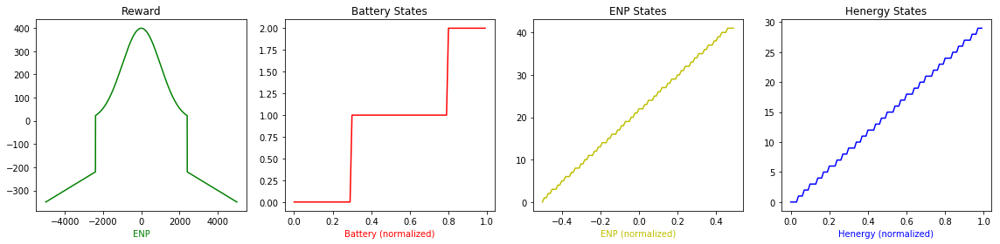

In [7]:
#Check reward function
#ENP varies from -0.5 to 0.5
y1 = np.empty(1)
for x in np.arange(-5000,5000):
    eno.enp = x
    y1 = np.append(y1,eno.rewardfn())
y1 = np.delete(y1, 0, 0) #remove the first row which is garbage

#Check state discretiziation functions
#Battery value varies from 0 to 1
y2 = np.empty(1)
for x in np.arange(0,1,0.01):
    temp = sarsa.get_batt_state(x)
    y2 = np.append(y2,temp)
y2 = np.delete(y2, 0, 0) #remove the first row which is garbage

#Check state discretiziation functions
#ENP value varies from -0.5 to 0.5
#Inconsistent with the reward function 
y3 = np.empty(1)
for x in np.arange(-0.5,0.5,0.01):
    temp = sarsa.get_enp_state(x)
    y3 = np.append(y3,temp)
y3 = np.delete(y3, 0, 0) #remove the first row which is garbage

#Check state discretiziation functions
#henergy value varies from 0 to 1
y4 = np.empty(1)
for x in np.arange(0,1,0.01):
    temp = sarsa.get_henergy_state(x)
    y4 = np.append(y4,temp)
y4 = np.delete(y4, 0, 0) #remove the first row which is garbage


####################################
##   PRINT FIGURES##################
fig = plt.figure(figsize=(16,4))

ax1 = fig.add_subplot(1,4,1)
ax1.set_title("Reward")
ax1.set_xlabel("ENP",color='g')
ax1.plot(np.arange(-5000,5000),y1,'g')

ax2 = fig.add_subplot(1,4,2)
ax2.set_title("Battery States")
ax2.set_xlabel("Battery (normalized)",color='r')
ax2.plot(np.arange(0,1,0.01),y2,'r')

ax3 = fig.add_subplot(1,4,3)
ax3.set_title("ENP States")
ax3.set_xlabel("ENP (normalized)",color='y')
ax3.plot(np.arange(-0.5,0.5,0.01),y3,'y')

ax4 = fig.add_subplot(1,4,4)
ax4.set_title("Henergy States")
ax4.set_xlabel("Henergy (normalized)",color='b')
ax4.plot(np.arange(0,1,0.01),y4,'b')

fig.tight_layout()
plt.show()


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -133.1724687960358


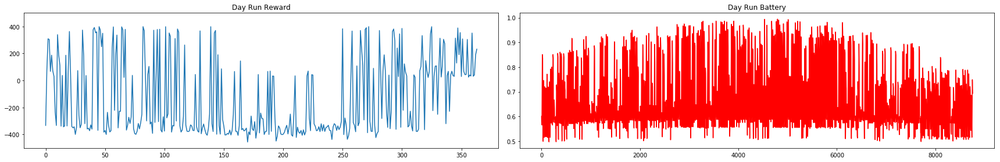


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -84.68029299149603


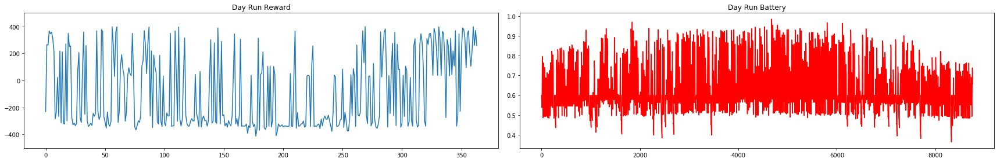


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -81.7940470870389


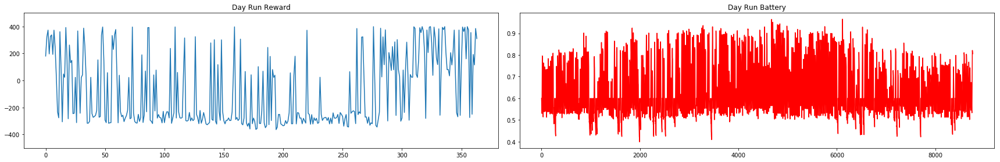


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -102.3519551715572


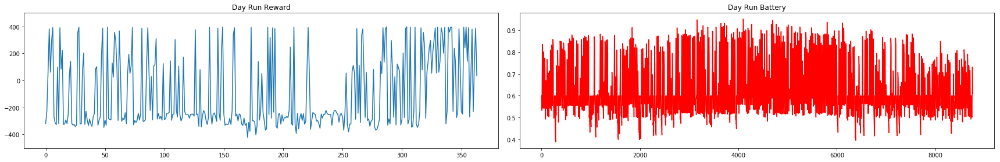


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -22.370461571008175


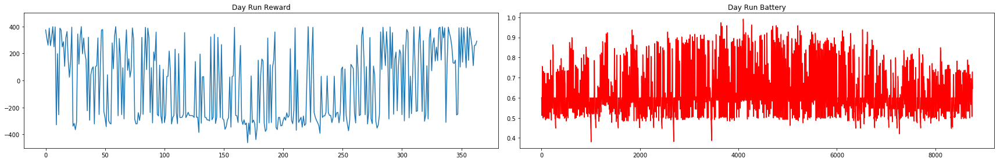


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -71.43121705387671


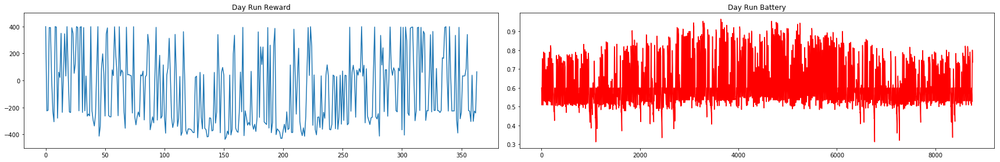


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -43.20980803203318


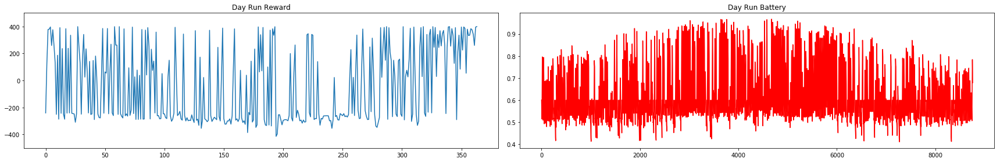


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -61.232226199249205


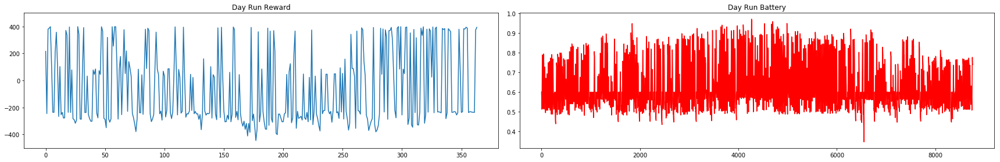


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -4.51168241650857


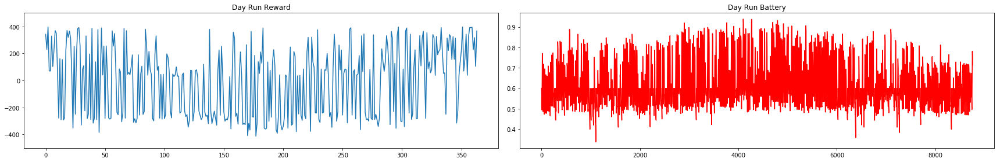


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -14.651725091904314


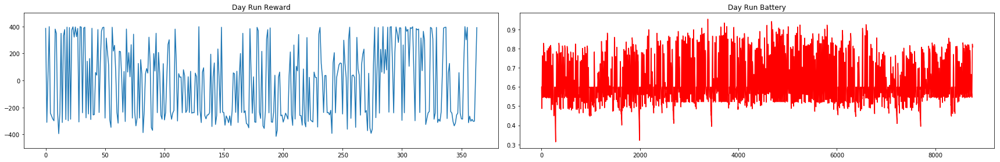


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -133.6894259139979


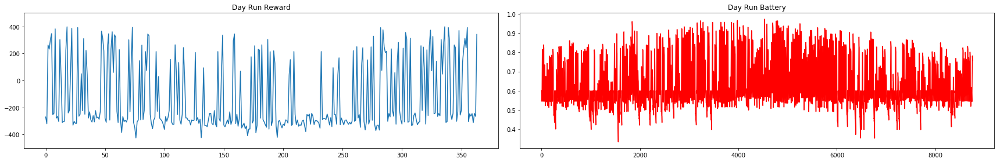


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -69.18121999055788


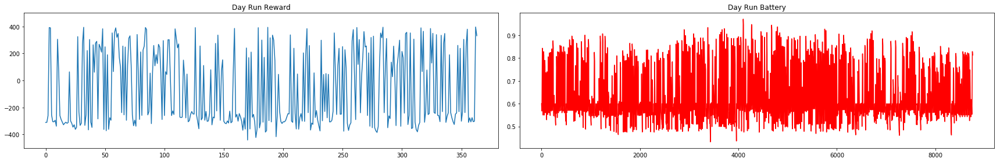


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  2.8513453197470233


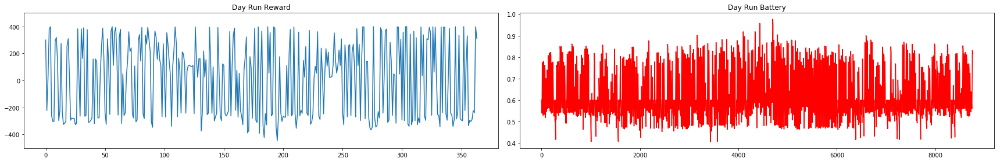


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  171.69835446803108


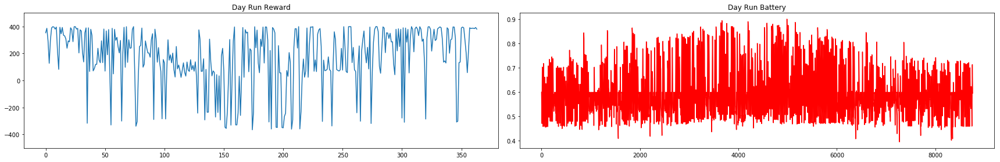


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  99.58601496135864


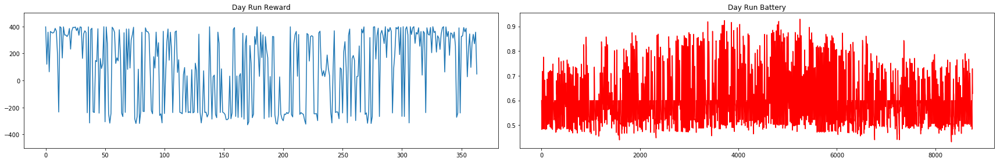


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  70.52080504403571


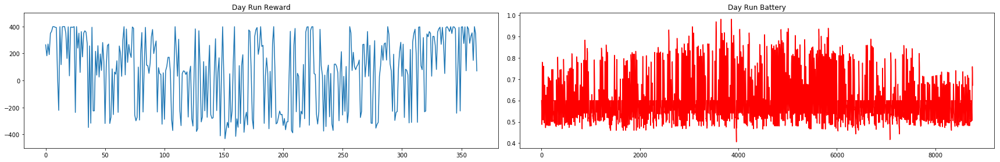


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  53.88429447985703


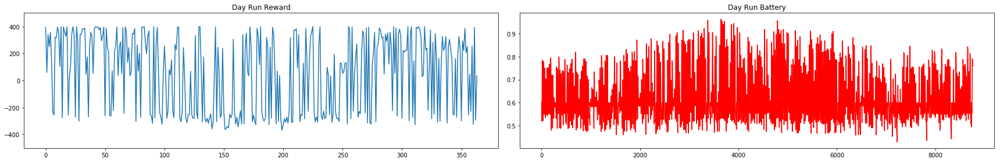


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  131.7814308866331


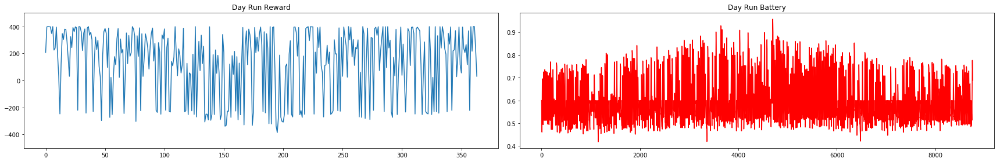


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  63.317453274069514


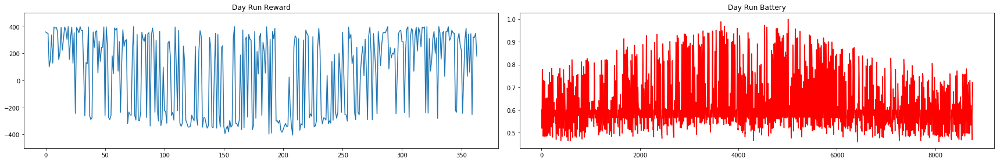


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  32.19608055792957


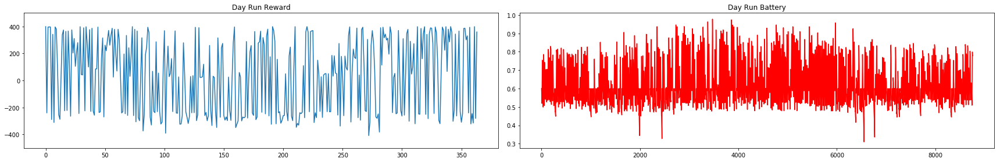


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  115.7994070158464


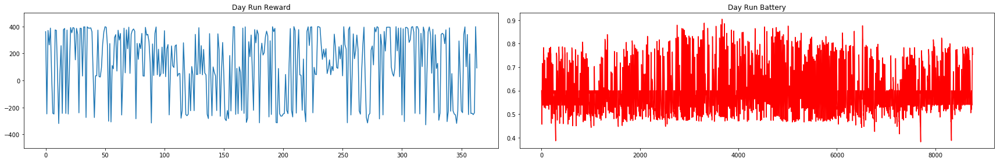


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  56.46557398538671


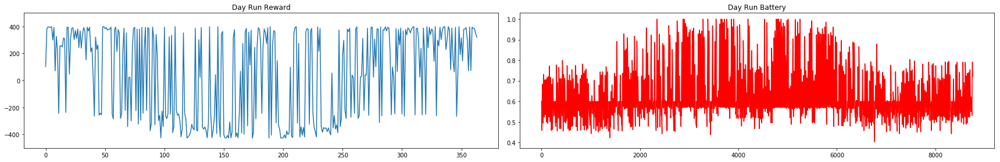


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  122.36478645071149


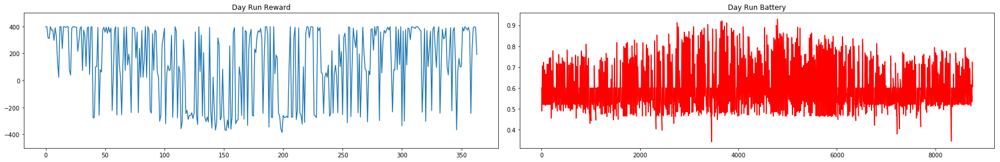


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  77.08299162658552


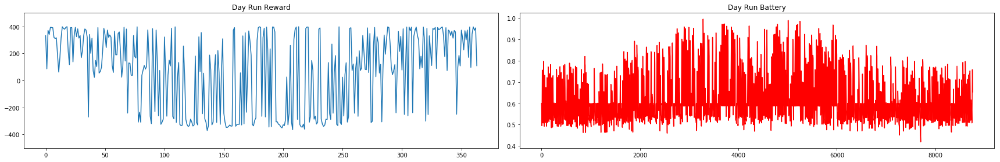


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -20.234117328655962


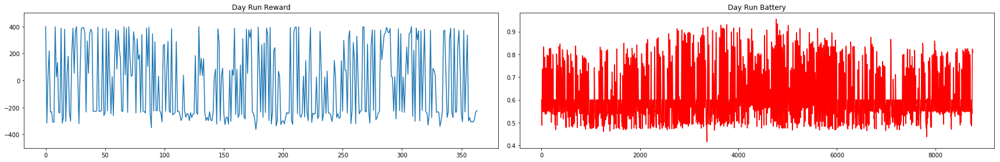


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  62.77388151781542


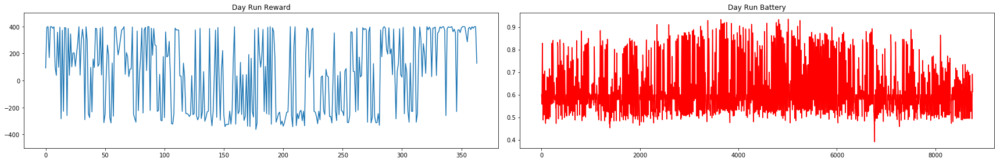


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  80.44491617616458


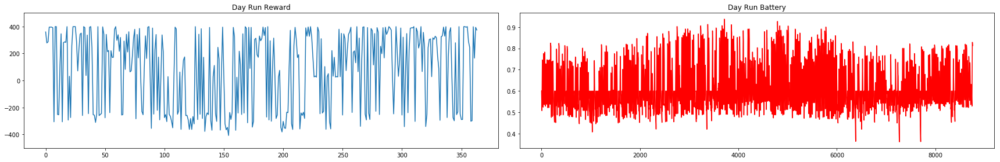


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  99.49207715608793


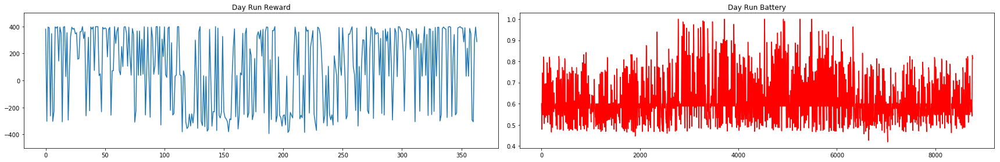


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  166.5875570945509


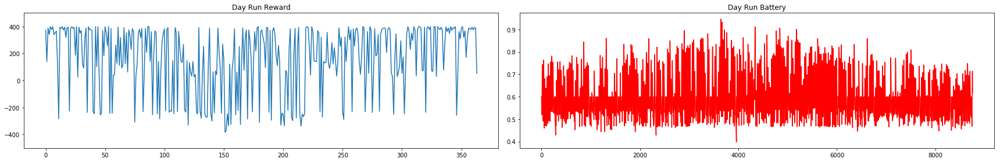


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  175.49847052354676


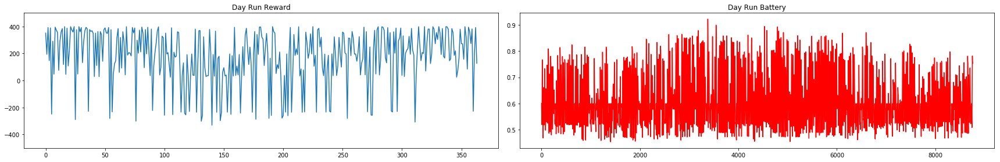


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  102.2410379430215


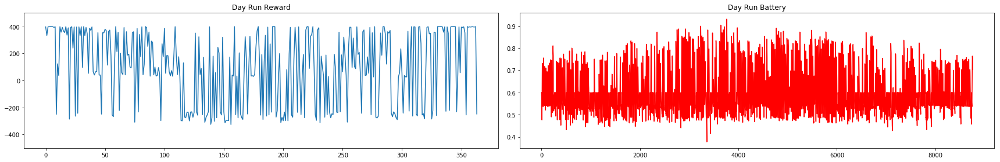


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  120.96109918982339


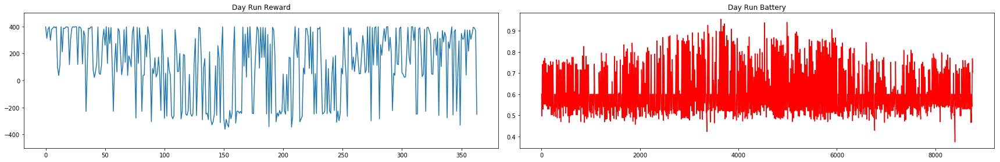


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  78.81330989818848


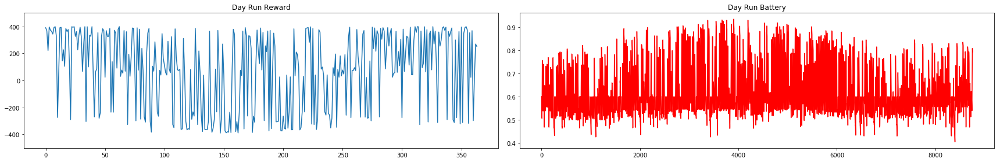


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  115.28513132620957


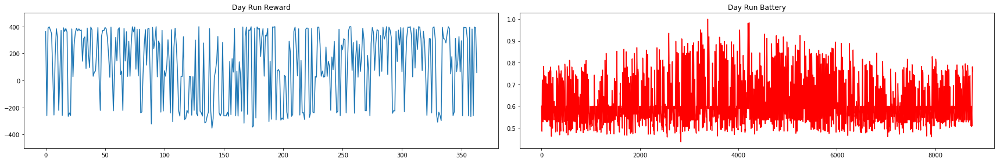


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  42.54273715300238


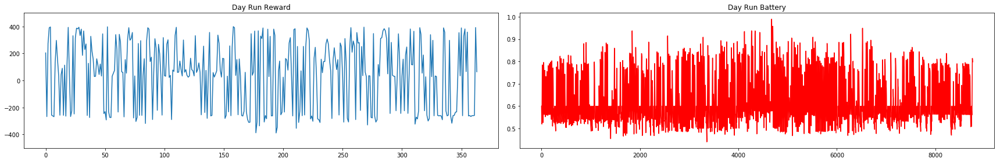


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  83.26790217259365


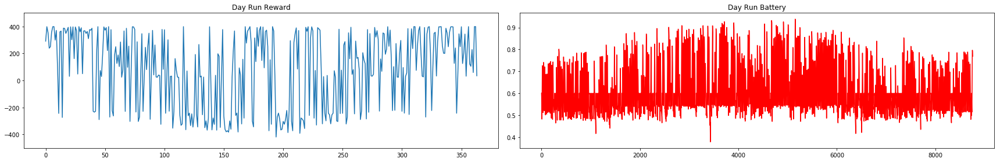


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  21.658526687583755


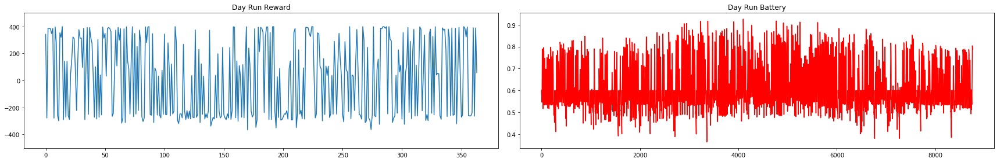


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  29.217426907322288


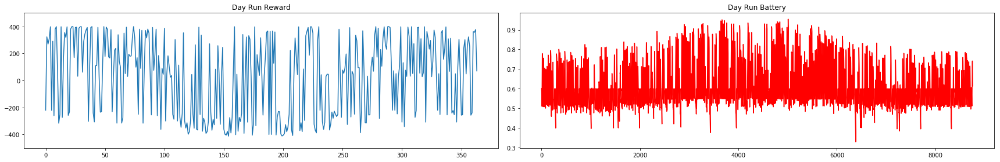


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  151.60919765976666


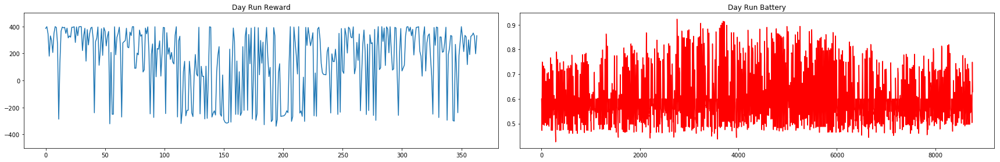


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  29.998728715753074


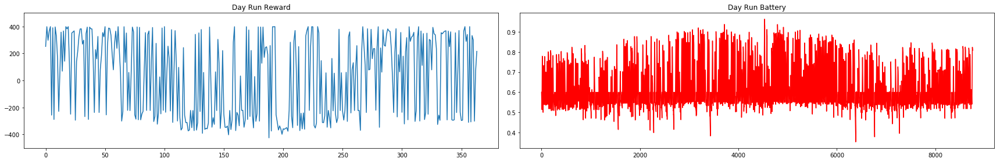


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  54.20261183185299


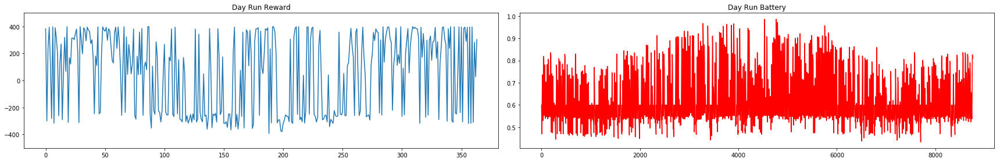


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  64.38549586372602


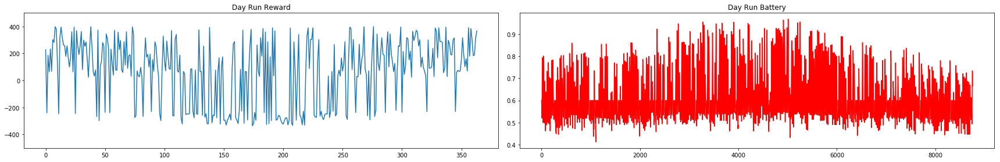


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  86.58399356714624


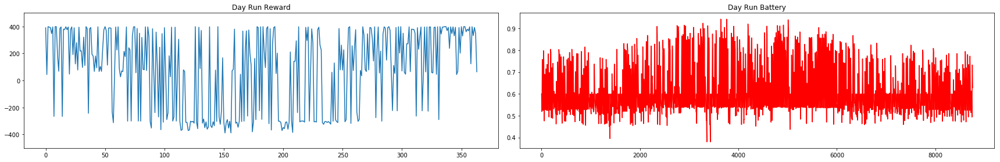


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  116.76160902353345


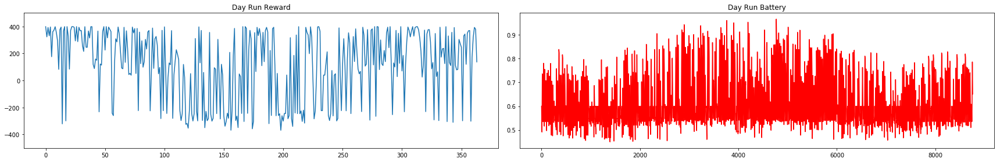


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  82.25199115624014


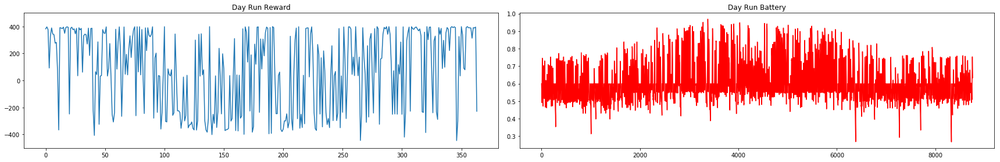


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  158.7549304806185


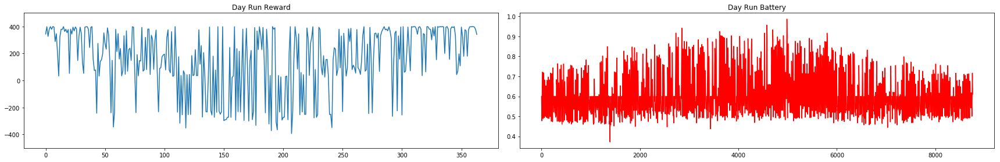


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  96.09138482574517


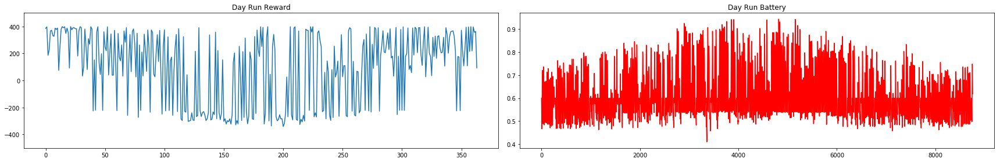


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  109.66305522301587


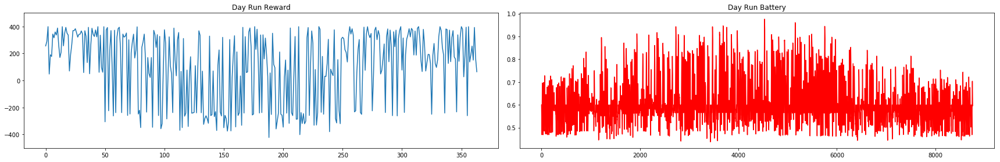


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  196.3267449425416


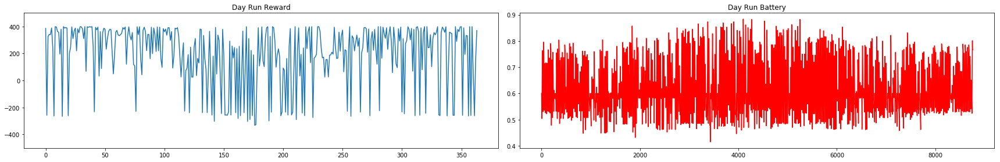


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  52.158578381487445


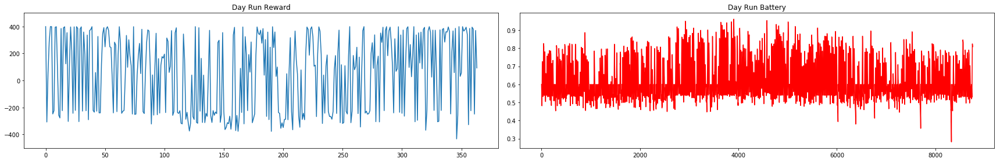


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  68.91202291196666


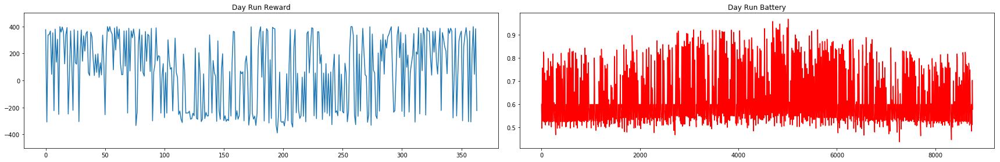


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  165.67065754972683


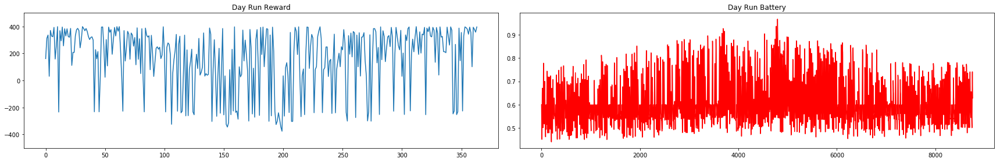


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  70.97765436814268


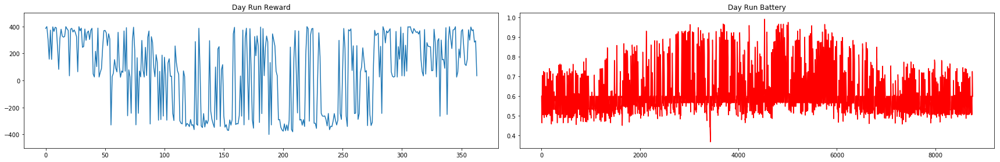


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  124.84454257933324


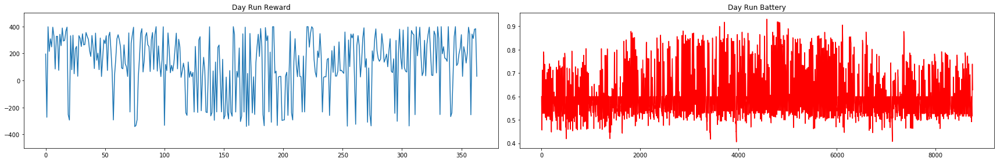


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  137.7424371907753


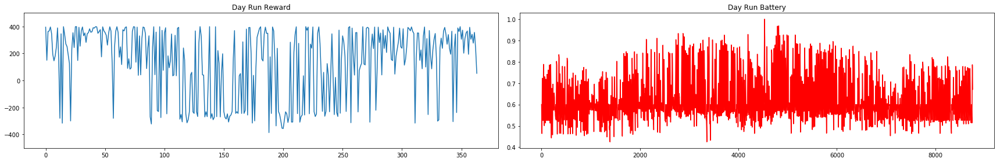


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  80.44052442107046


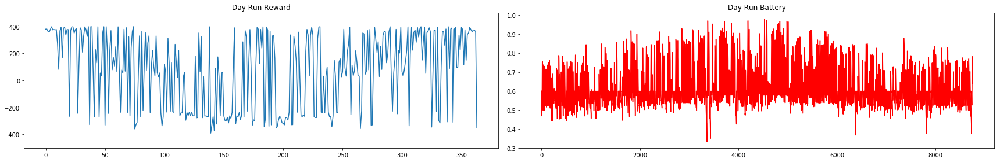


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  30.26608425426112


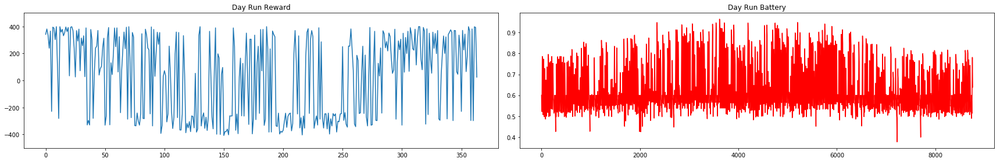


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  146.1598273516531


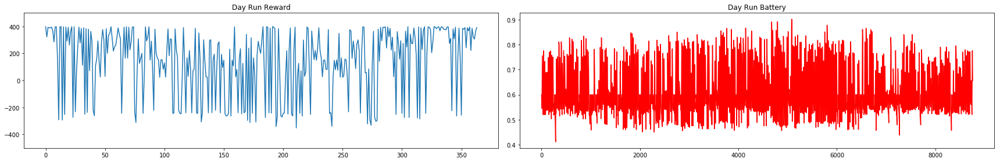


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  45.543941813073516


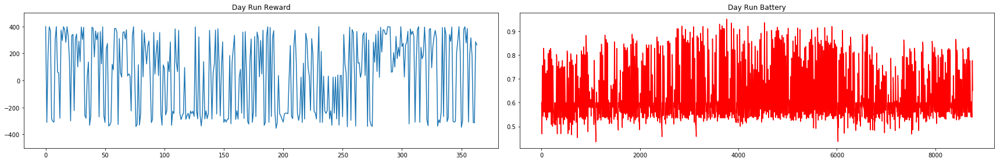


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  64.21718574098475


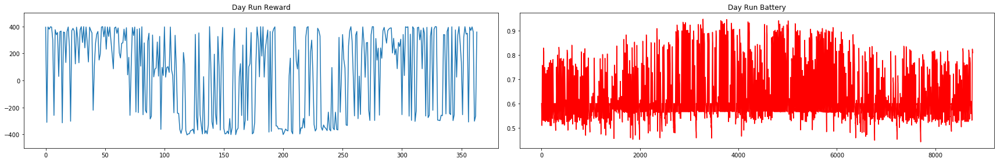


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  57.03566391588516


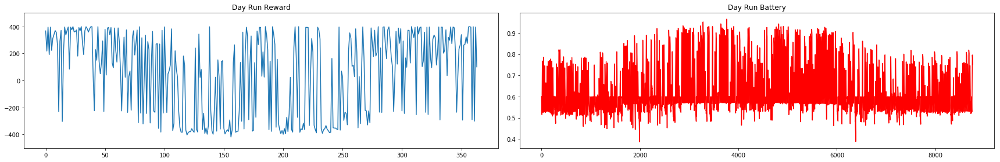


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  110.27328678179117


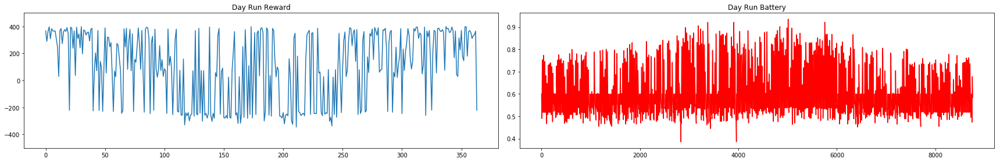


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  13.963694030977479


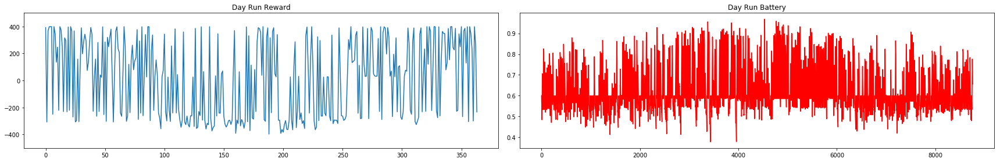


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  140.27096081318157


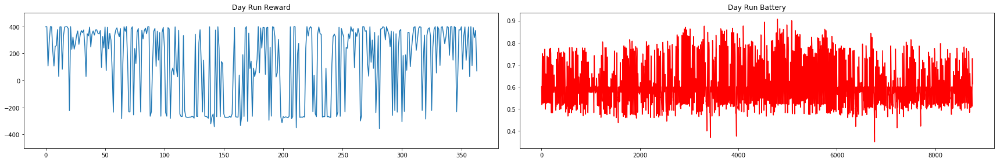


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  166.75079882090574


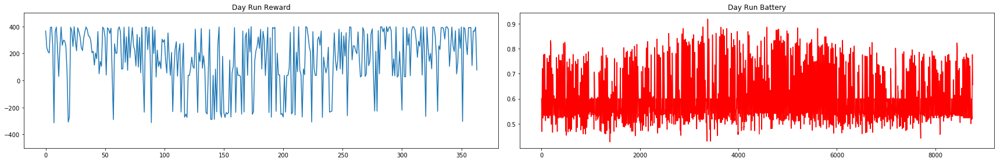


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  88.21163541103283


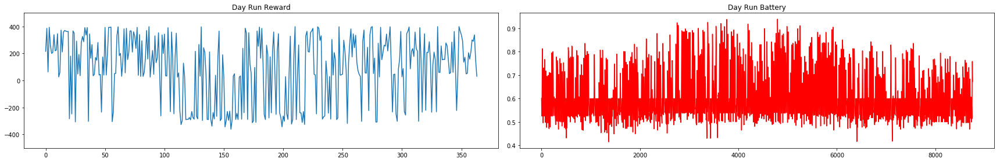


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  159.7236387015333


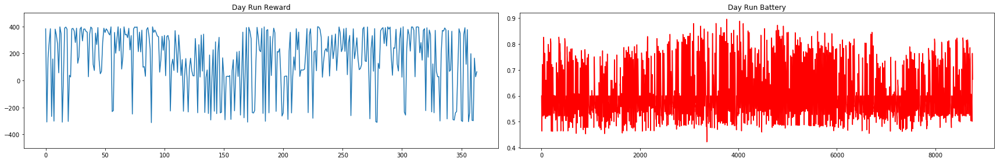


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  109.11187817626633


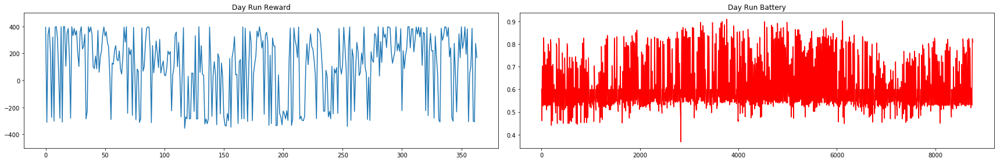


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  121.5644007134071


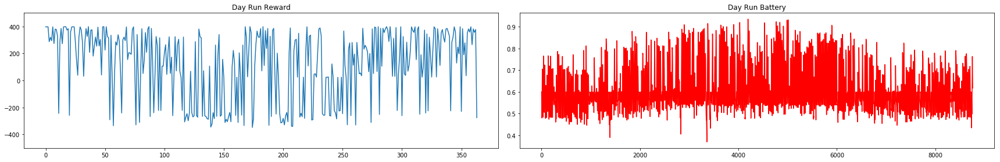


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  145.6322902022667


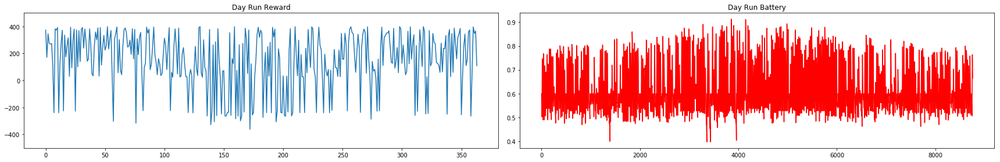


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  83.39283016124732


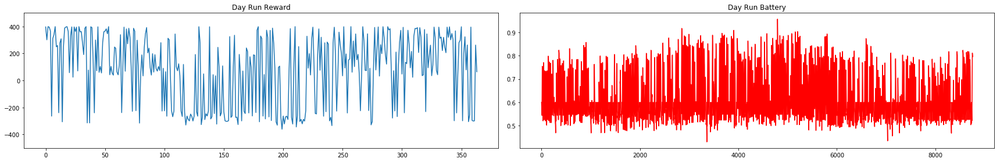


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  190.26832638821065


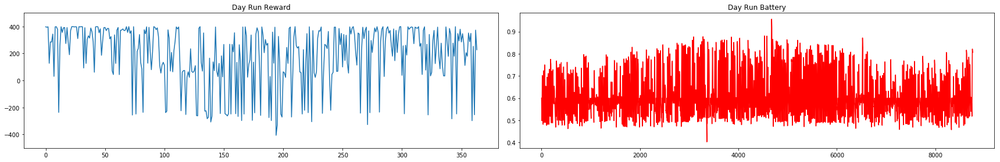


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  158.20748110890494


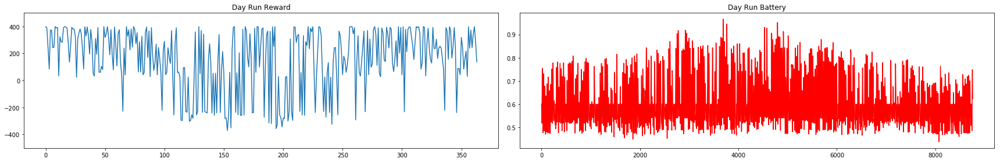


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  125.25372934326221


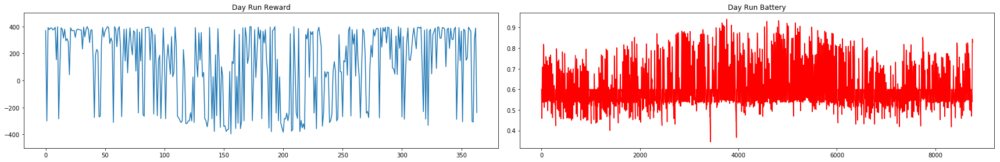


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  130.34280780680783


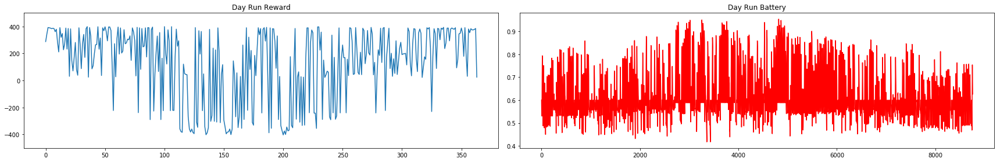


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  54.38568591497838


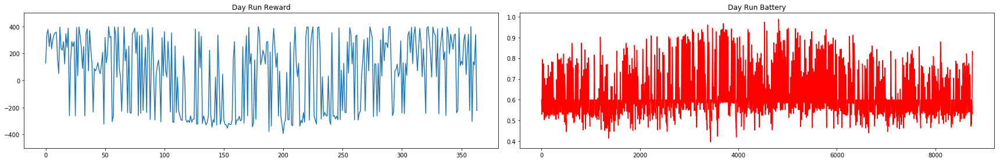


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  133.6357028079481


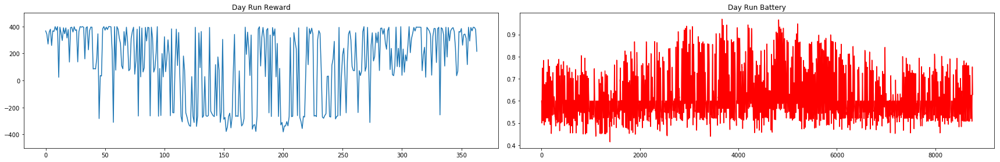


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  171.3482737377345


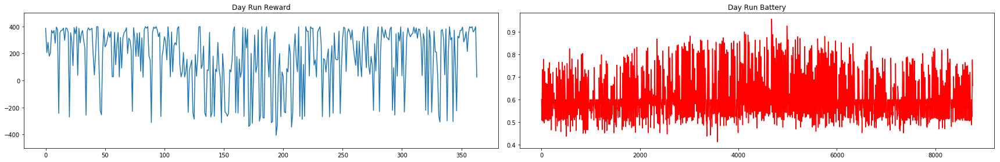


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  106.61957974264138


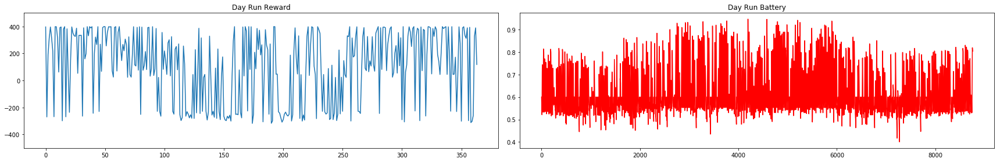


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  108.57409009107612


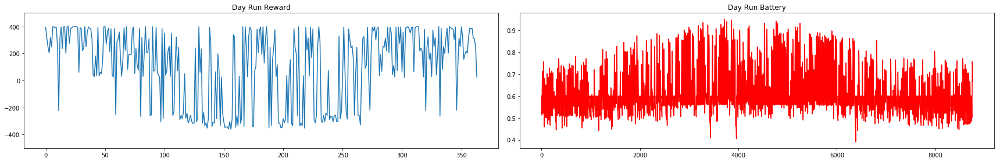


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  137.0925006946623


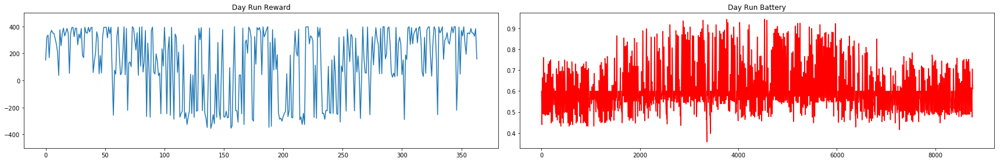


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  102.93346051357298


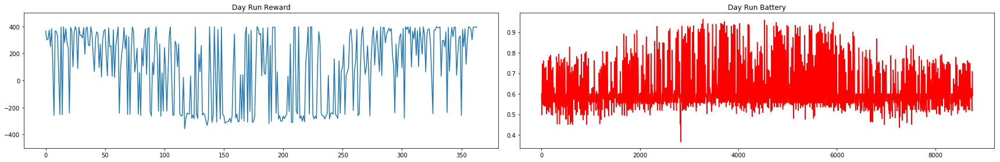


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  131.45938142320873


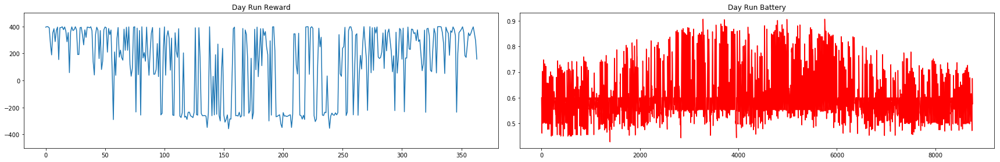


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  100.63890157754425


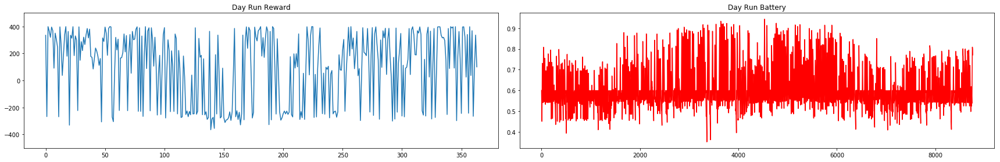


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  118.18259338867371


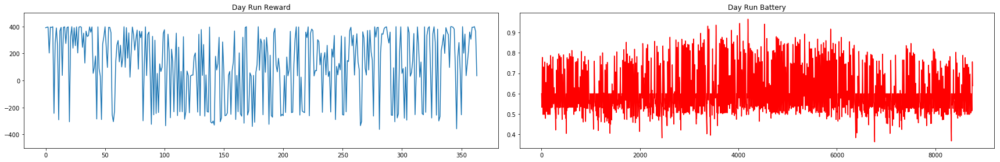


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  104.84689832456428


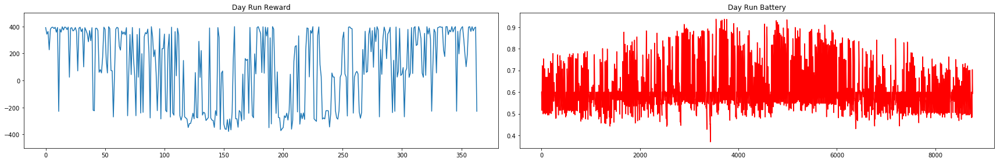


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  100.00602119339031


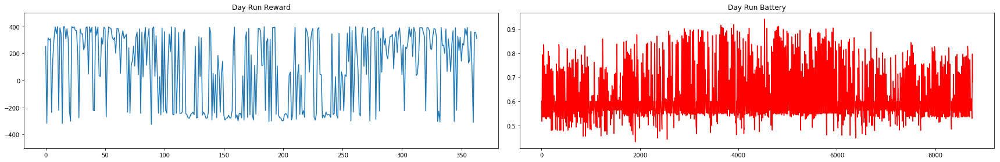


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  54.84370470670006


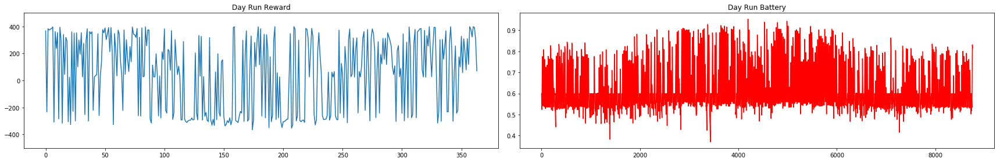


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  53.73782131802969


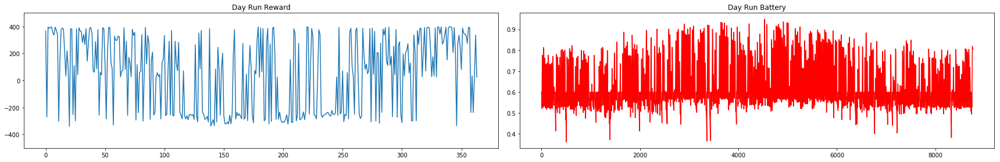


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  101.68728598303302


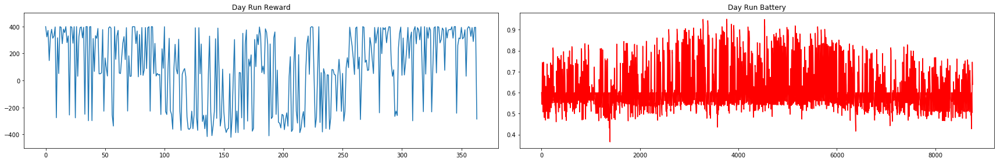


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  49.47995362093627


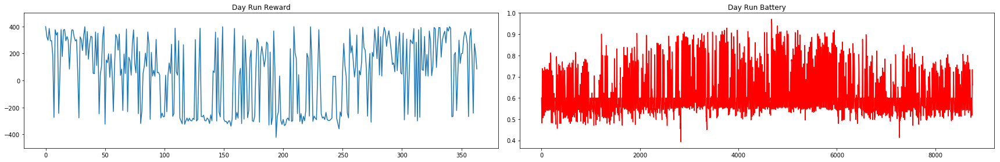


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  119.40512002817098


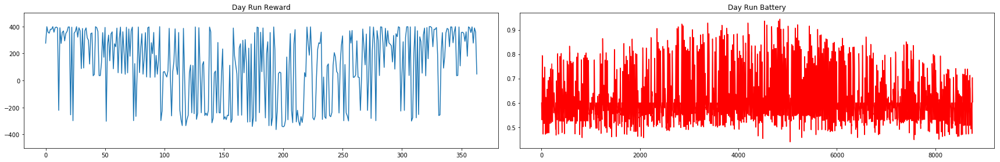


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  43.6519751382894


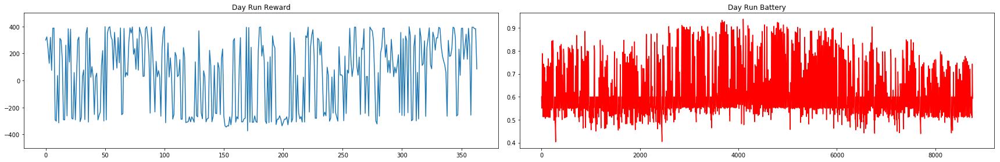


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  144.63342412715156


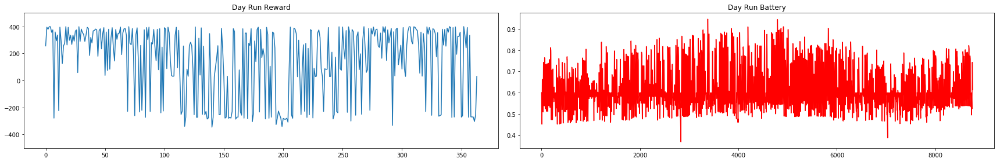


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  41.64675986583843


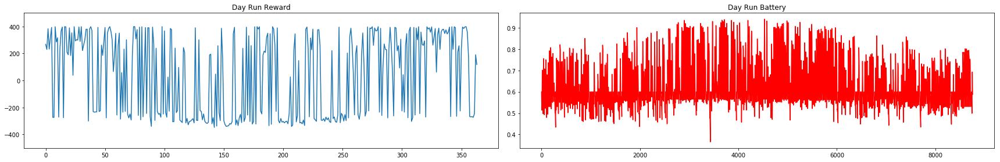


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  29.492345605102514


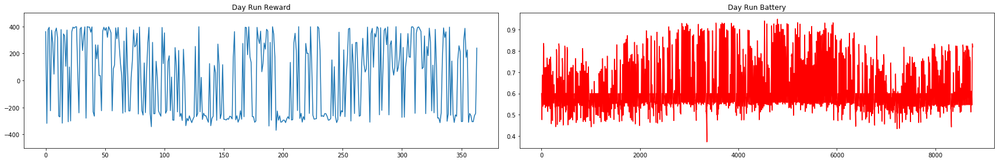


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  91.21422112152057


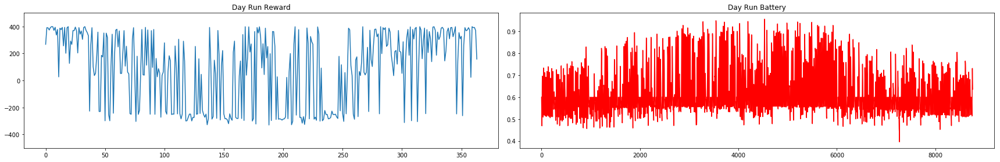


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  70.27357431975355


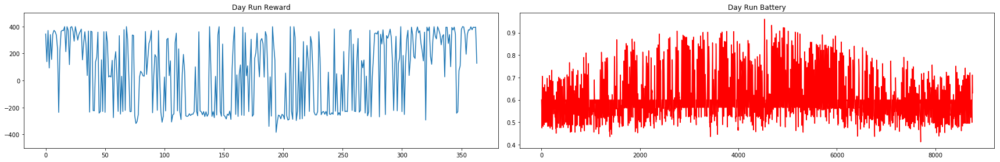


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  87.29131174733494


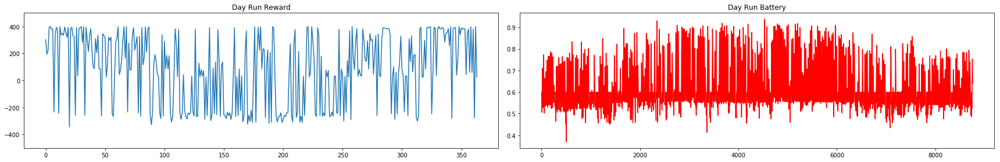


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  108.99432308937119


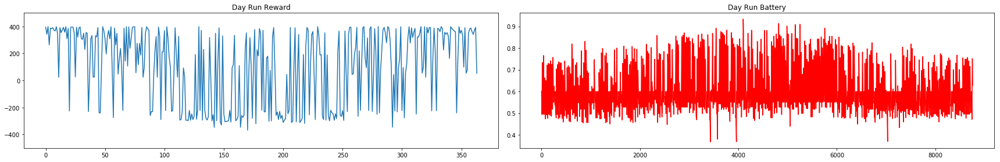


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  119.40672594930736


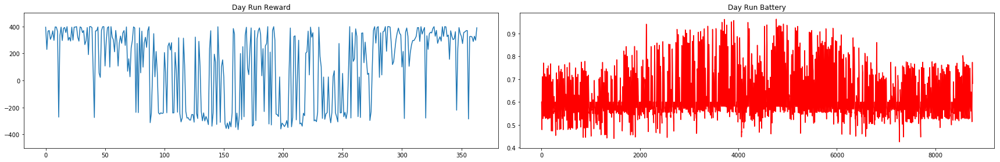


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  86.92040275960115


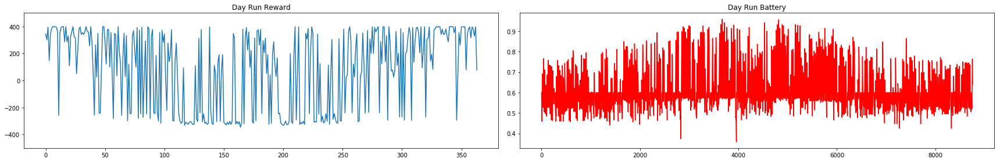


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  74.33497351048851


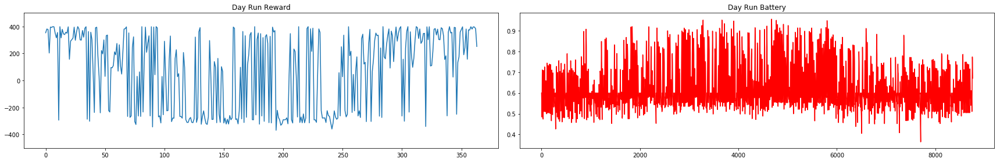


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  63.504670814704276


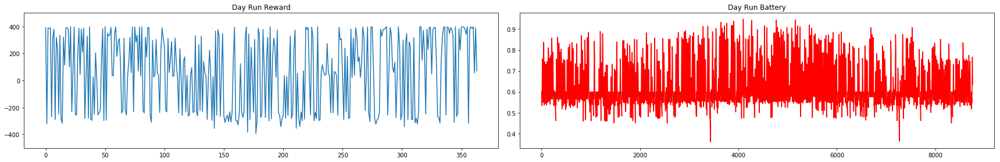


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  165.40893469497263


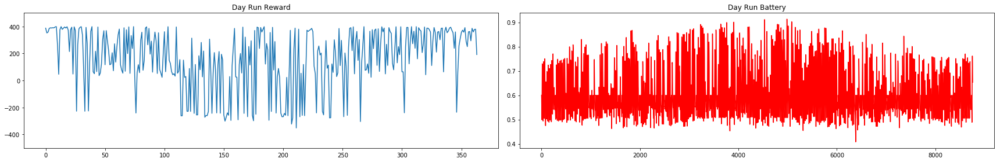


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  56.31380850174509


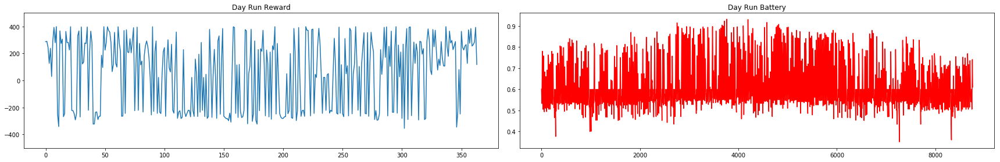


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  115.3944289446756


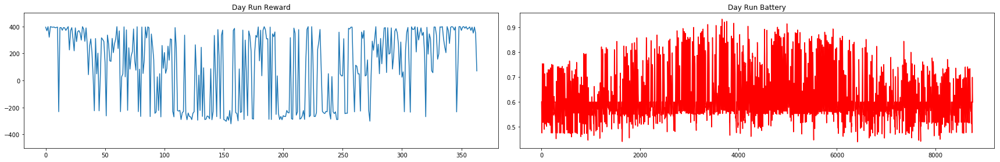


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  72.13027201180296


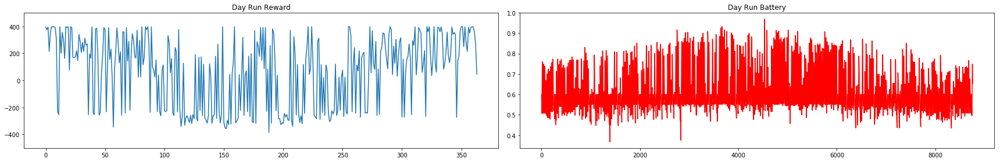


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  100.25229905623553


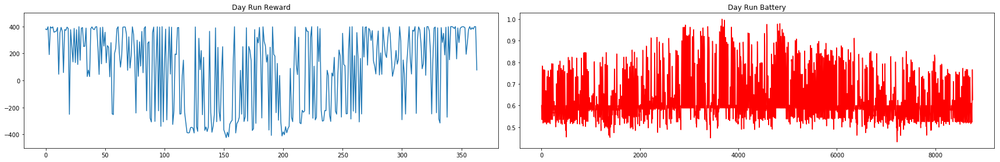


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  113.40703493179241


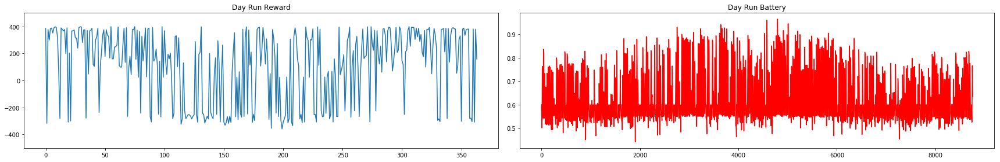


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  119.74152449427808


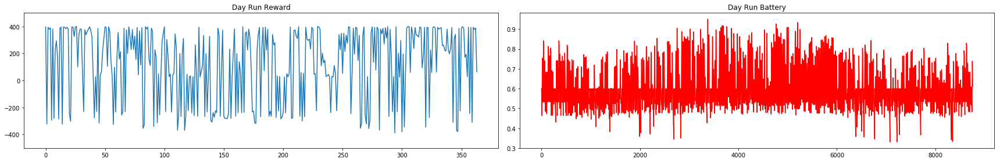


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  185.77758268662453


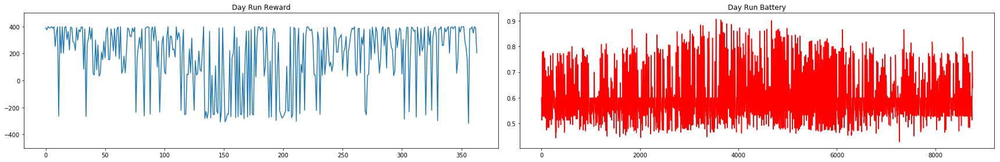


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  159.64909139941722


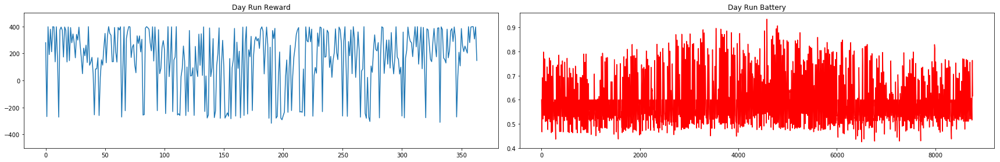


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  152.61899701387384


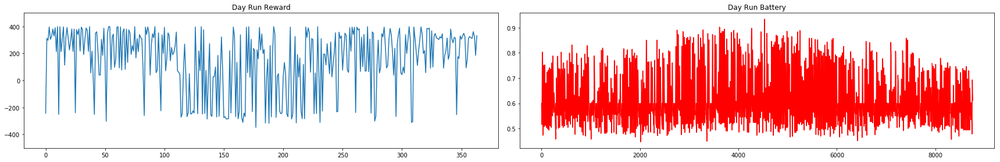


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  169.18198813024364


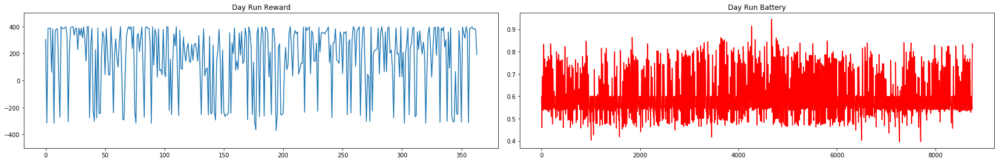


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  69.61811686949342


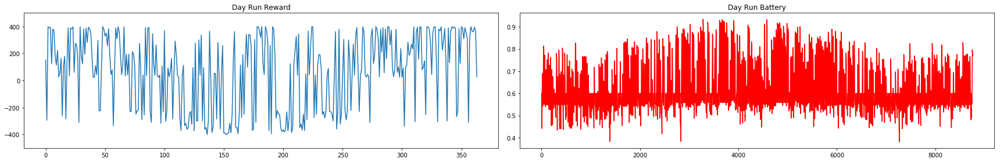


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  231.7931578397953


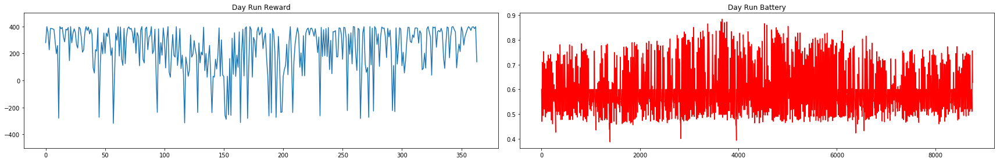


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  72.71887431236466


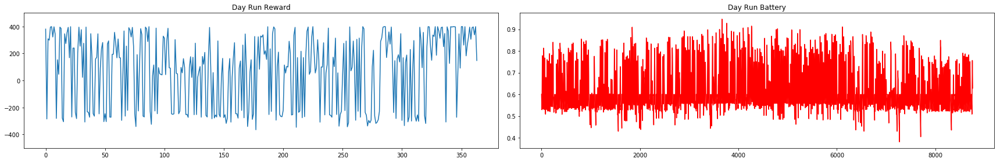


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  67.05484105902723


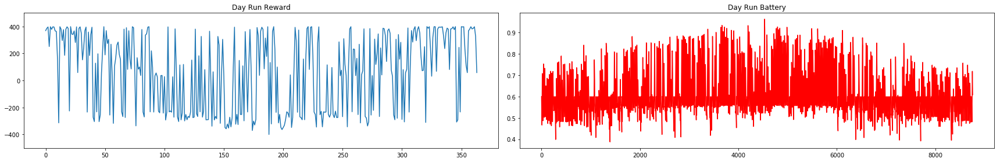


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  111.88762287550824


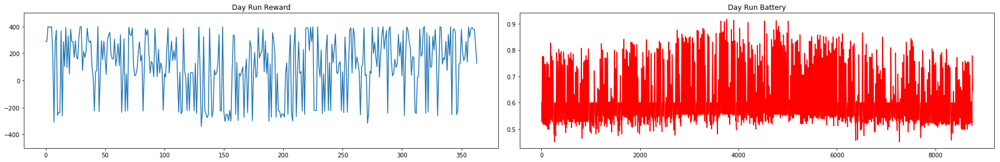


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  75.2600647040995


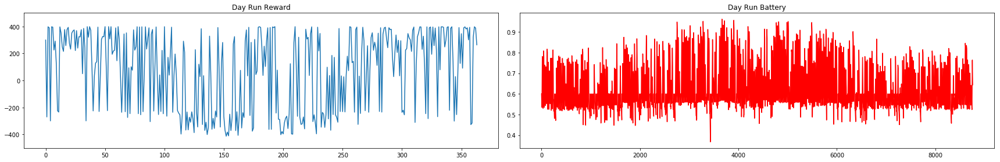


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  129.11167353698633


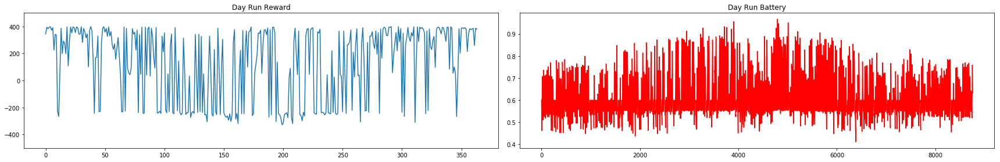


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  67.23651619598273


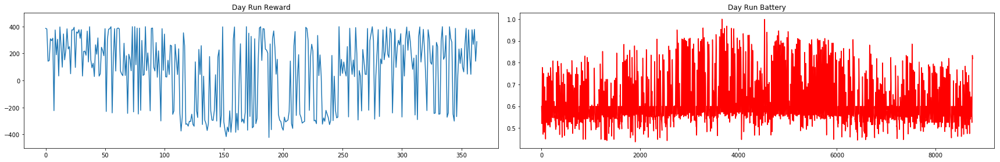


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  54.00453061714282


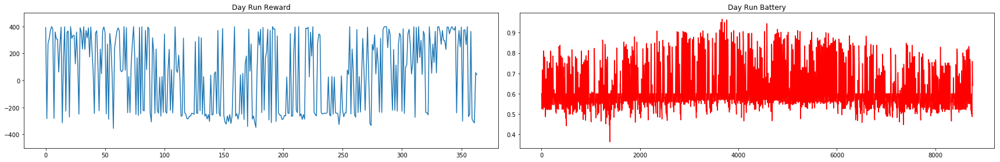


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  142.4511961994337


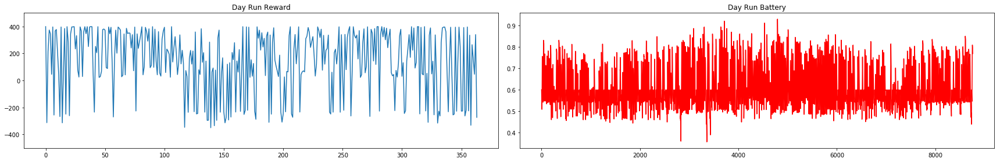


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  155.27102533018305


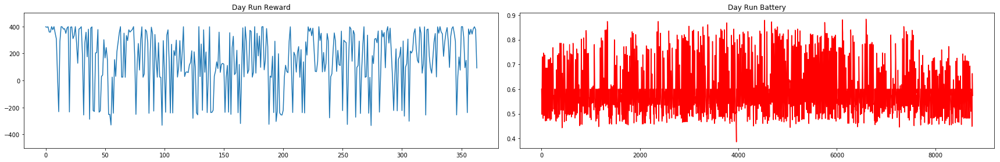


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  80.91868490688213


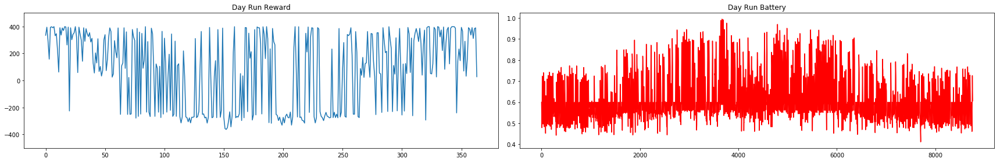


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  187.2014880247859


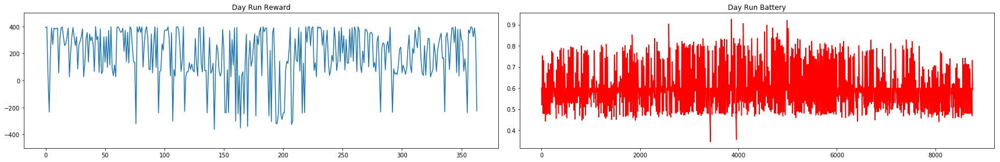


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  98.27642901517062


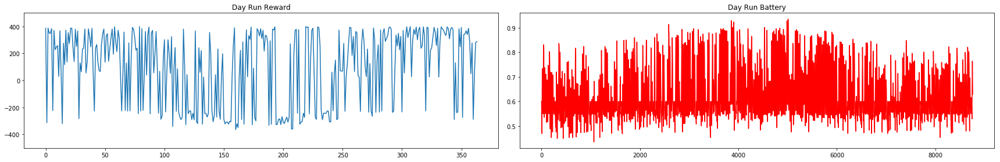


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  64.98377412618166


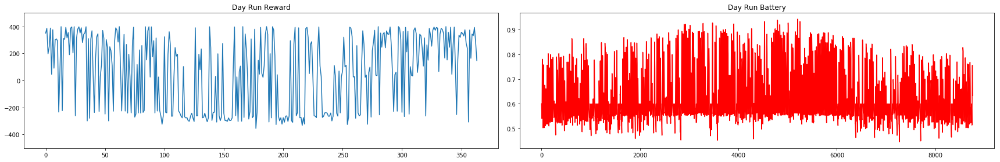


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  27.247237265528515


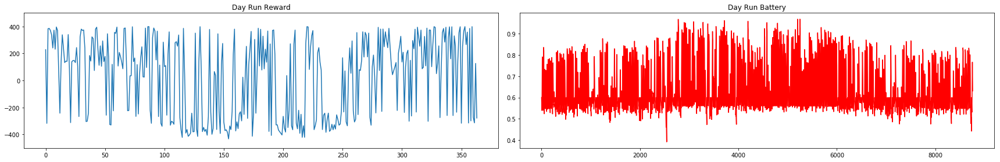


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  83.75528927690021


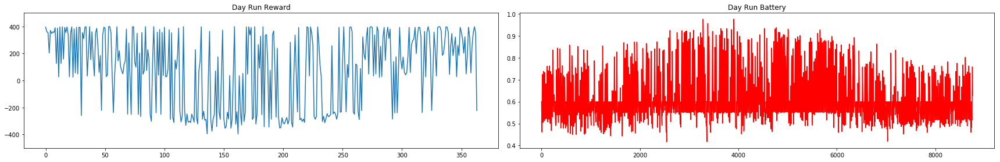


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  118.61564256099702


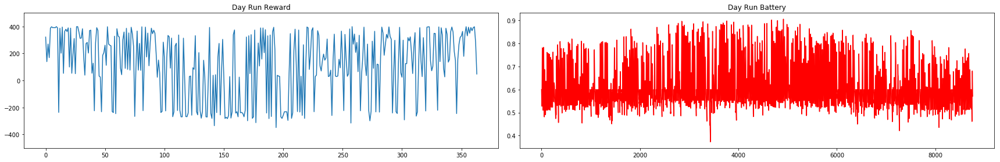


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  90.74403550838734


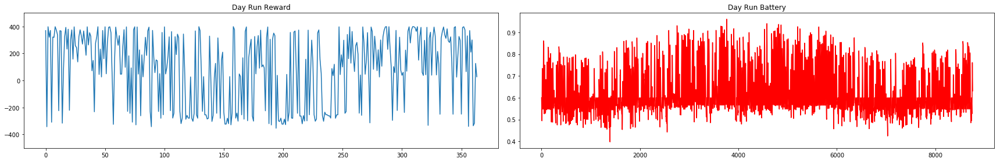


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  150.78280423637756


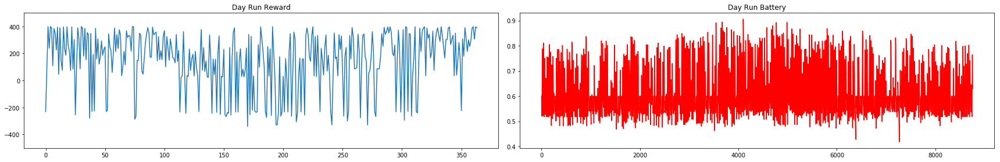


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  201.1572666872384


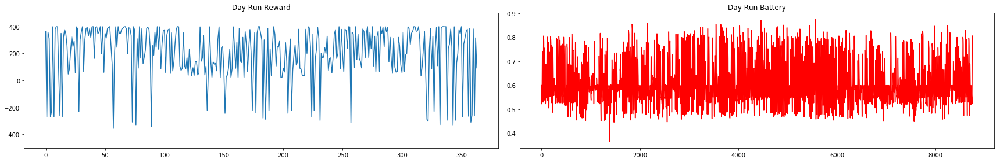


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  52.155939111161395


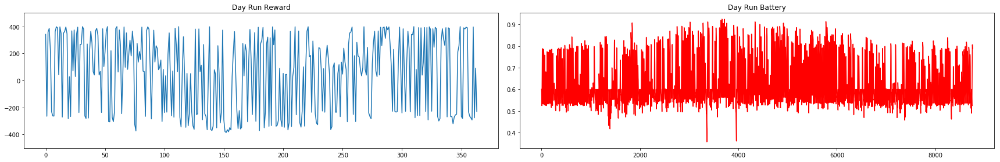


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  169.22817184487812


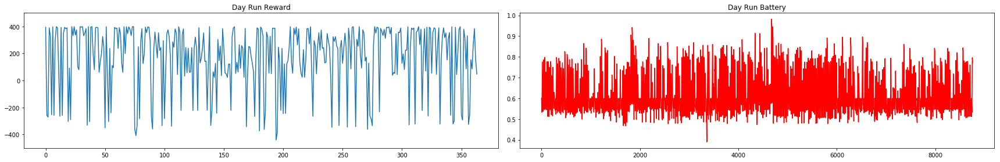


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  53.9539523543378


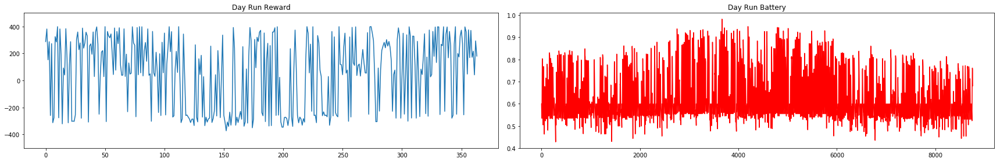


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  80.17158836382362


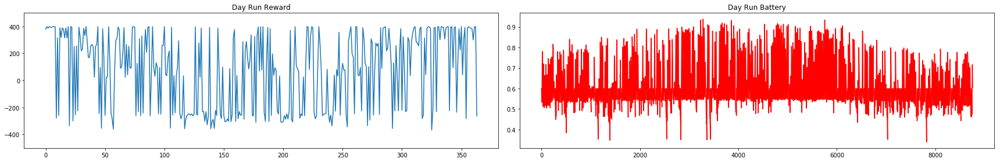


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  118.59768727106584


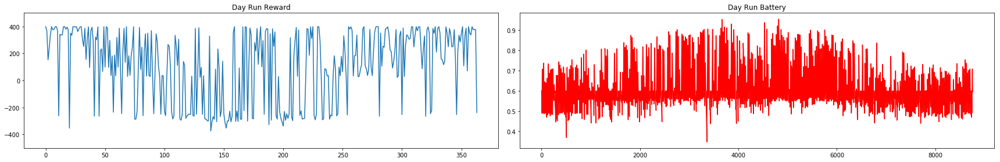


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  32.45569860010366


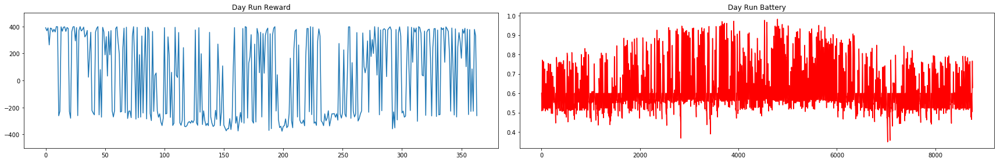


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  86.324995346984


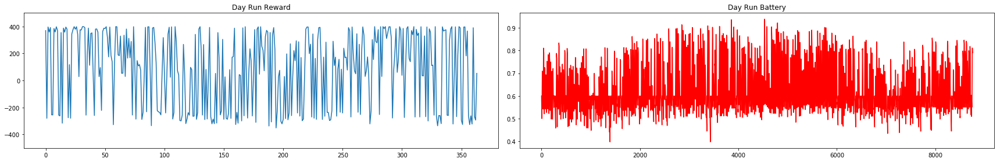


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  95.24157128616801


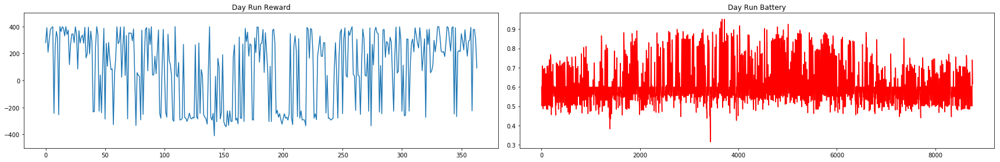


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  129.90790896034173


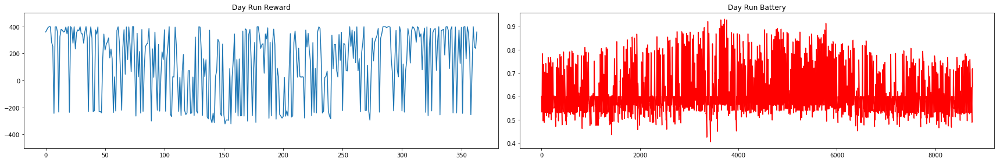


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  97.71269192332672


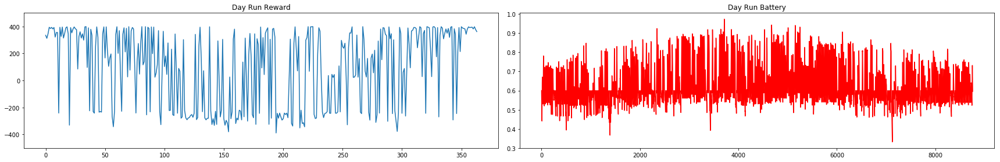


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  66.62733287193252


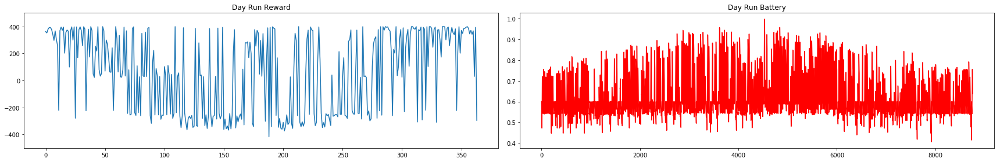


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  135.78798817666134


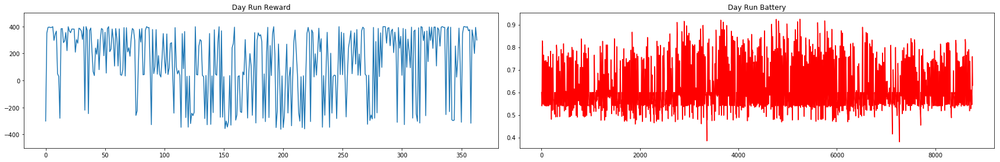


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  87.92178440859854


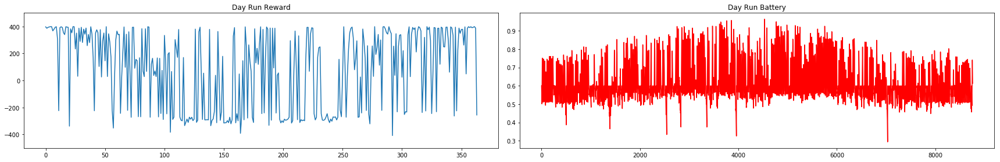


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  140.2357138590114


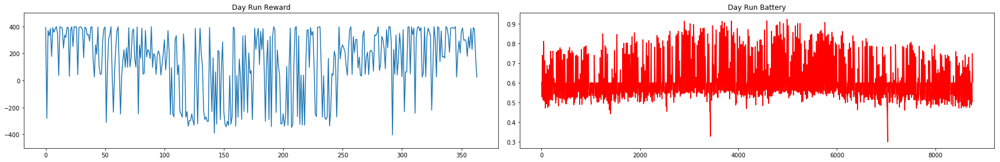


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  47.43945410862572


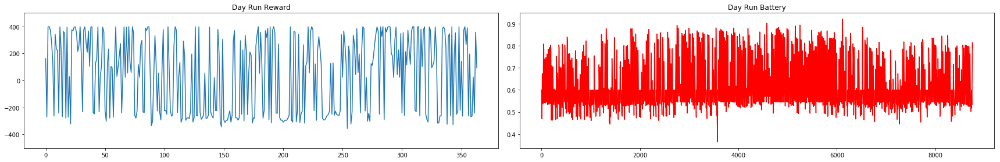


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  171.9669099663771


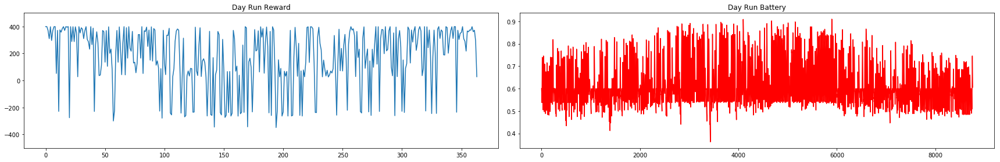


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  108.08780856944725


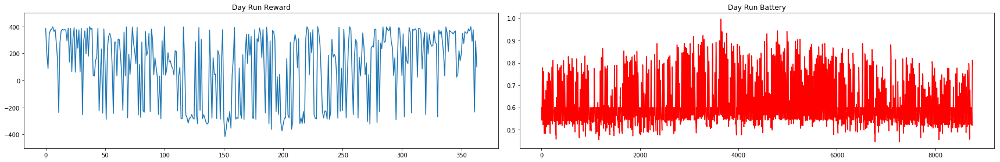


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  139.90719990673193


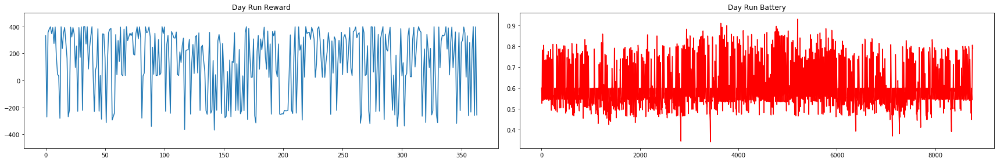


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  132.3913823688969


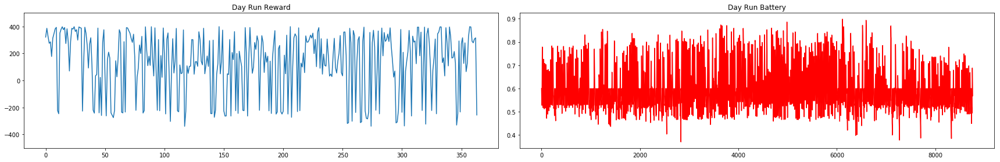


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  137.56421593940672


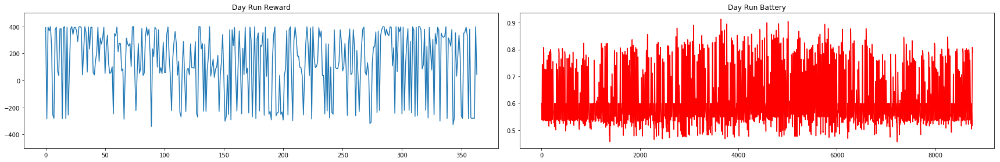


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  103.90074105257044


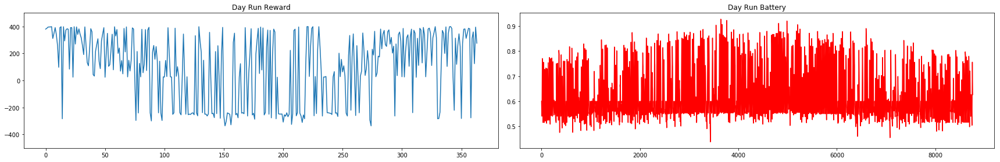


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  175.86823273683245


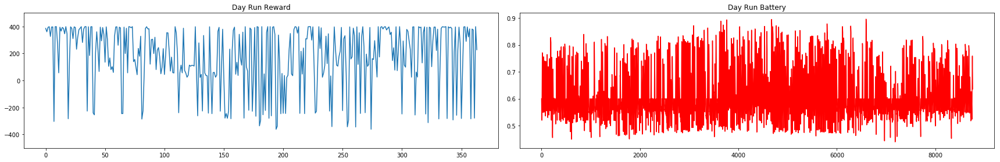


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  165.75312529791984


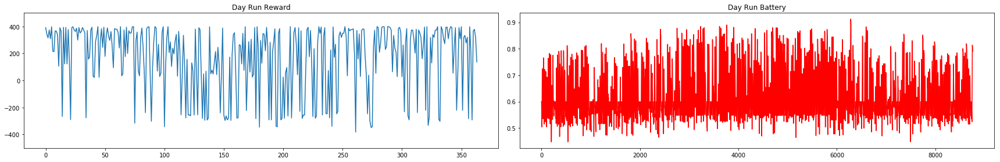


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  163.92512276488088


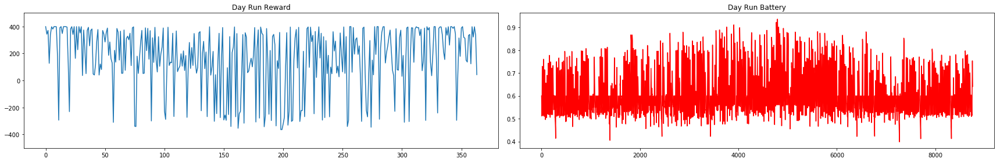


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  115.64095834000256


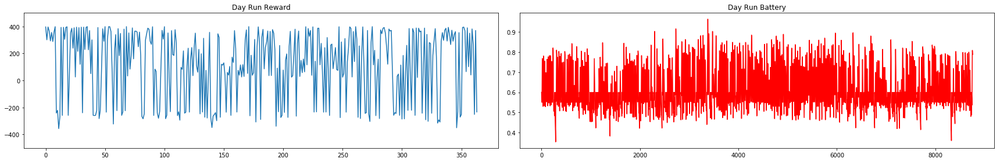


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  76.97599346177654


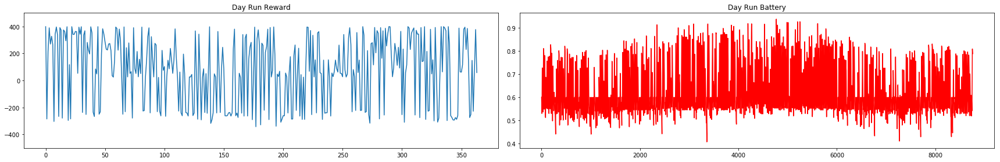


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  98.23430712355288


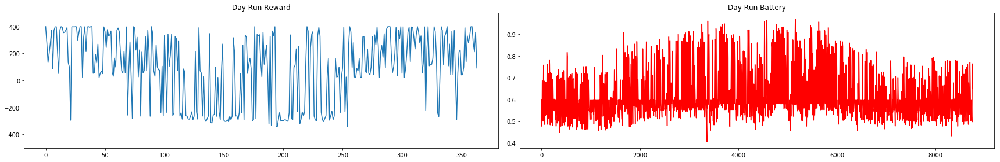


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  67.6029028976532


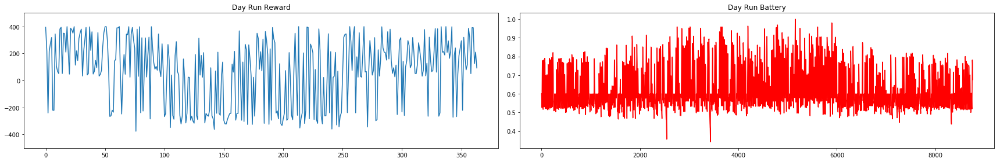


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  75.40876498166493


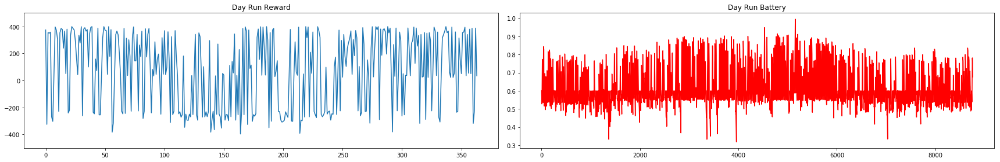


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  149.85132146818748


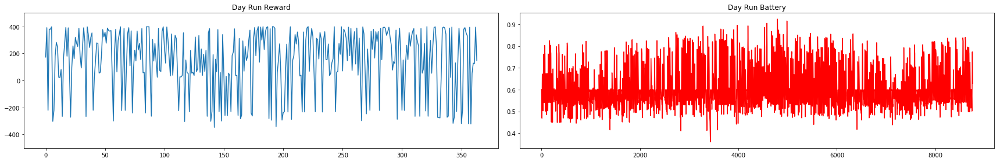


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  108.39704155547253


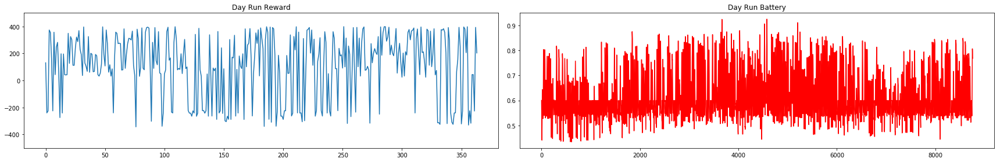


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  120.86318494098202


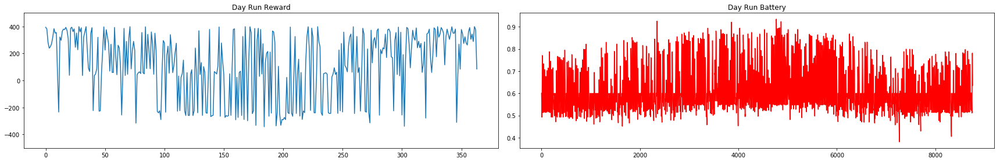


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  134.9875150449074


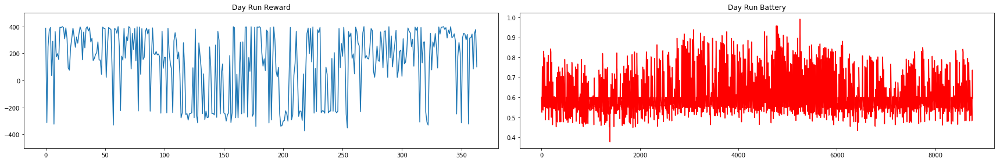


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  137.47978098947078


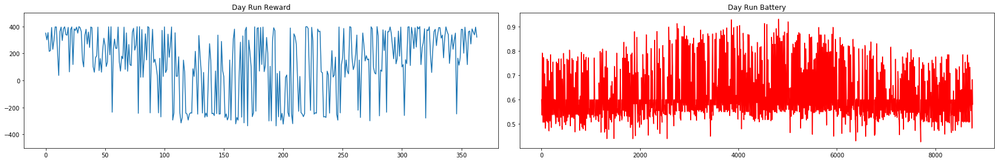


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  119.32504650410064


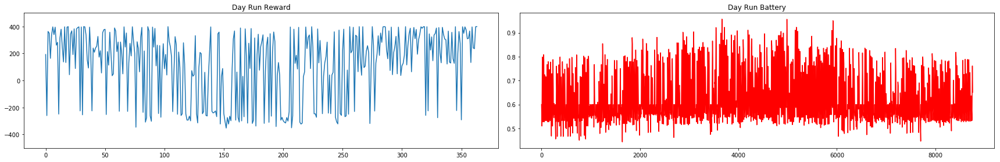


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  129.41186653921505


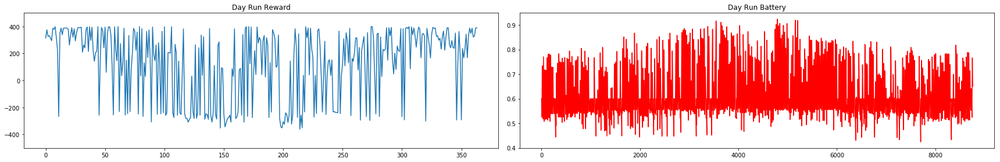


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  219.62693861916438


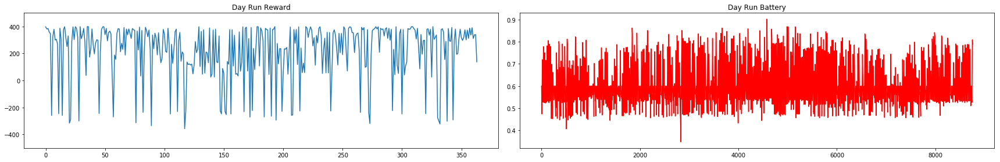


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  182.35371069694423


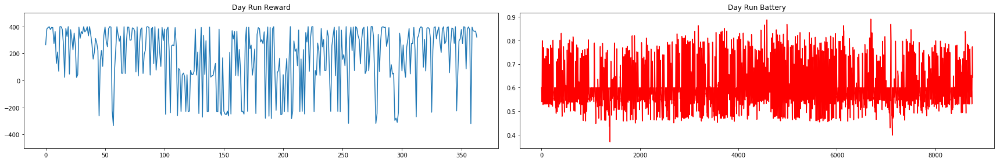


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  93.07599524584327


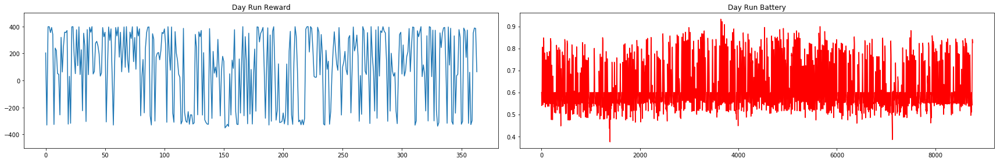


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  112.98969896862684


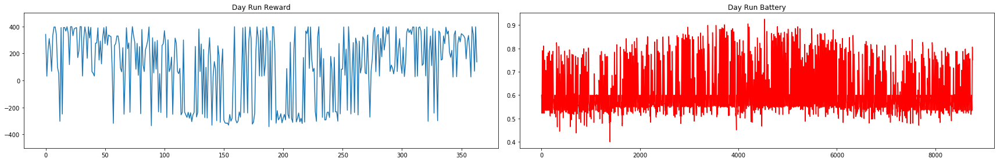


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  114.57747792341216


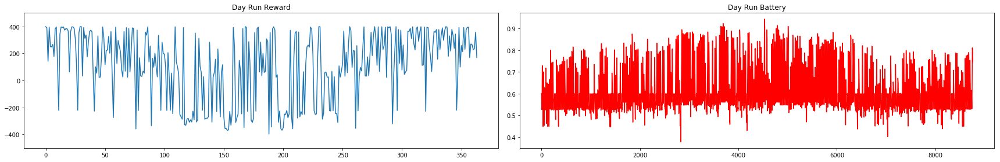


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  126.93180345706348


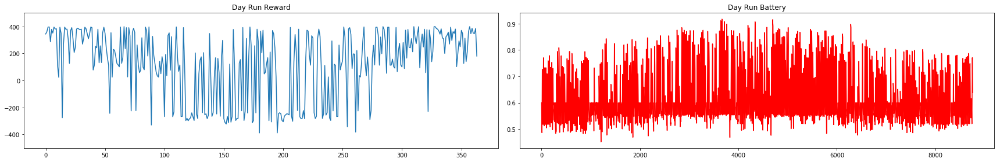


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  205.7636070609598


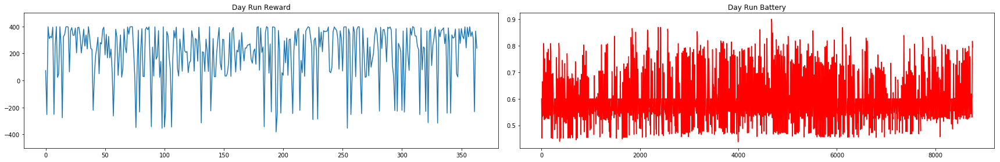


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  172.1327105594177


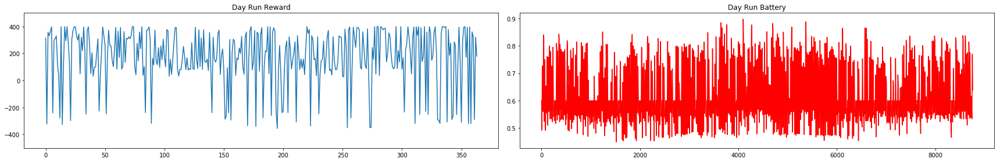


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  157.94565863869298


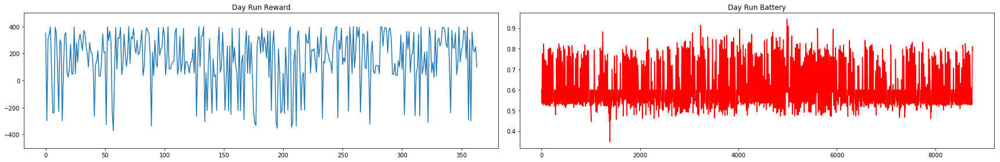


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  160.7949213613423


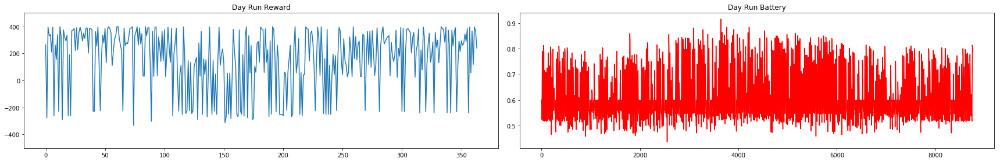


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  107.34854706352563


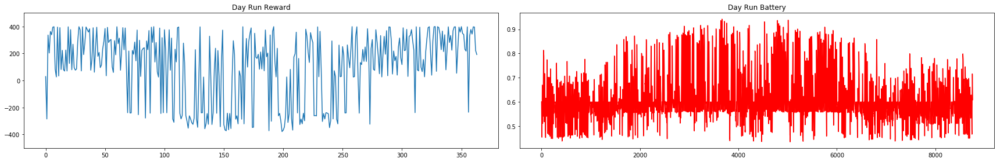


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  86.46464673780632


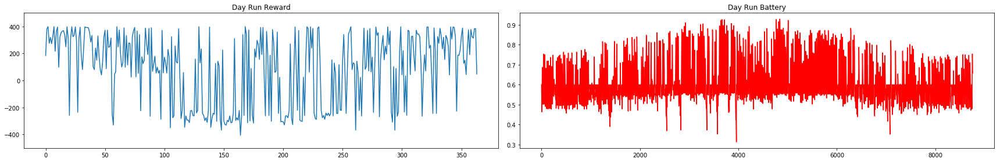


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  104.92335561389692


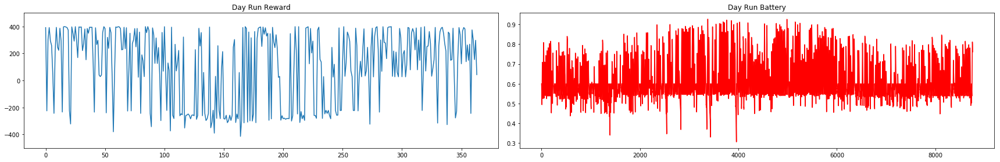


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  87.26165573209276


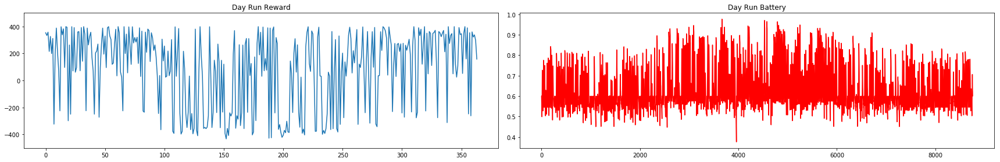


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  87.388162632764


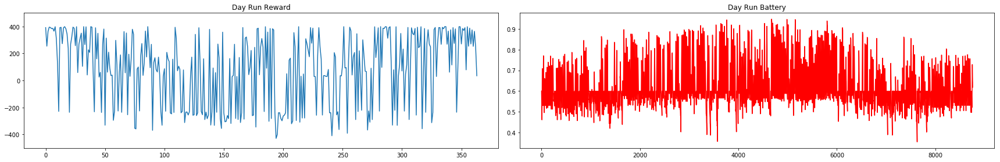


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  114.63589857111076


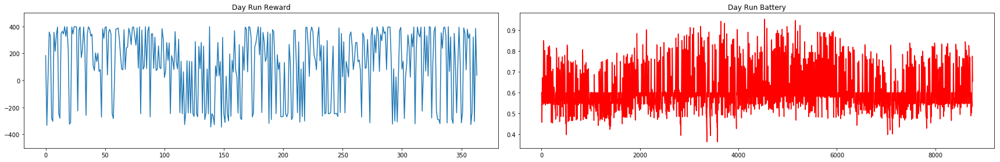


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  178.18897821368748


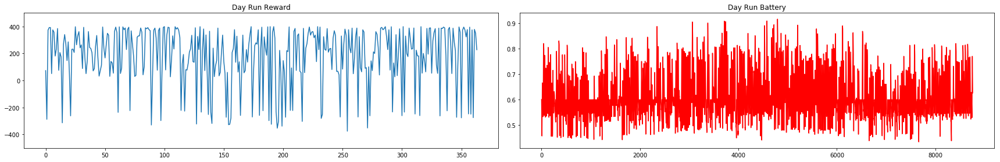


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  80.47958525943804


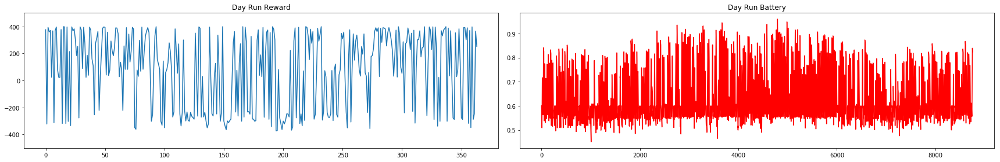


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  193.62996639461218


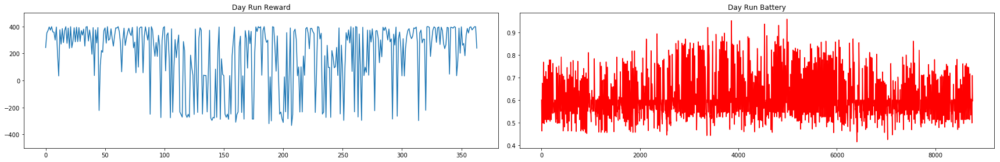


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  210.3058332073772


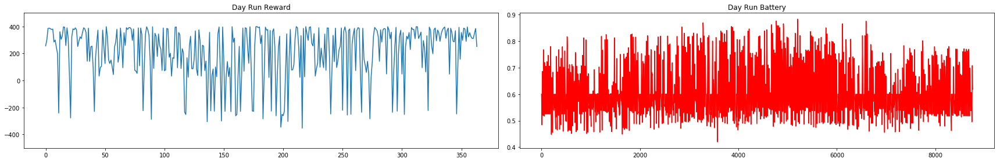


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  187.45780040877867


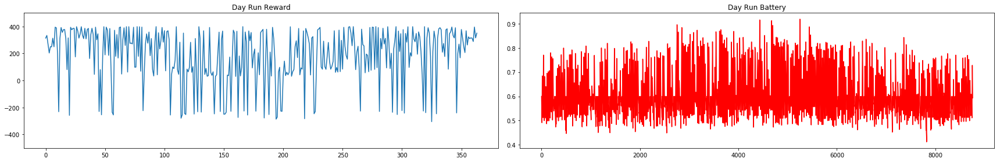


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  102.26901675544921


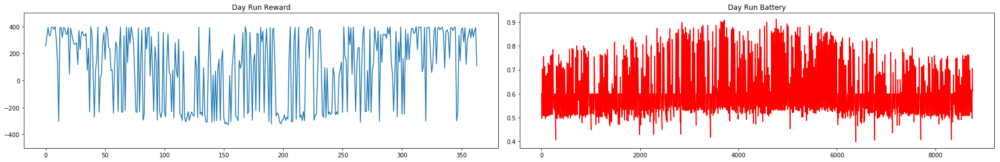


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  93.02150900564216


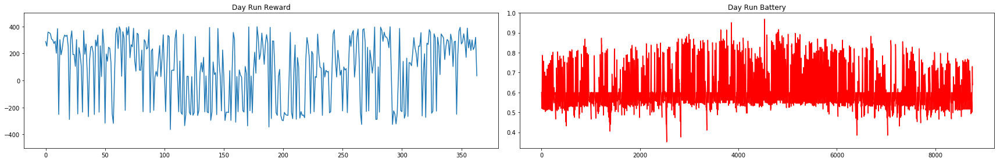


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  197.20440437425682


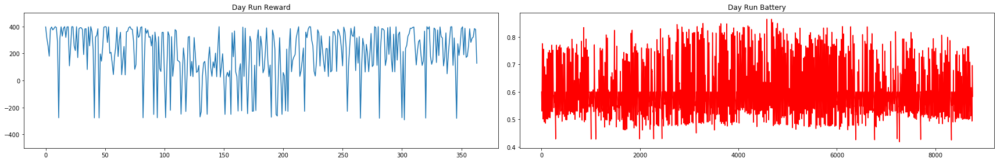


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  160.41286012787222


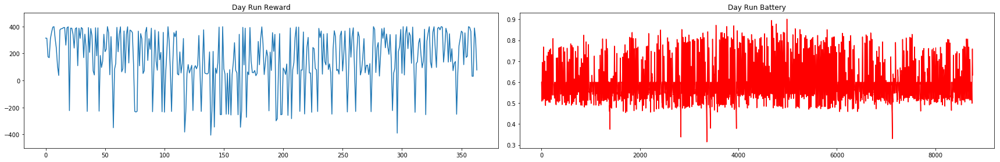


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  82.75540107898007


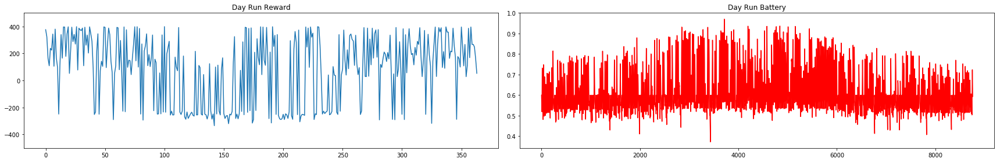


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  188.20817070073633


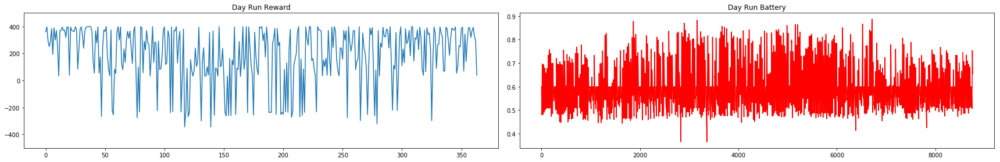


Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  204.0212966410081


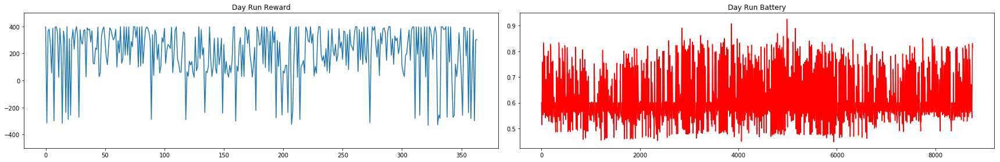

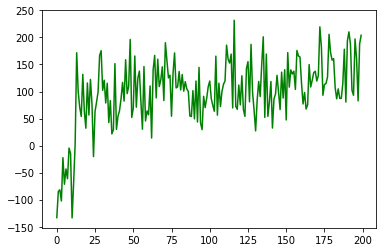

In [8]:
NO_OF_ITERATIONS = 200
avg_reward_rec = np.empty(1)

for iteration in range(NO_OF_ITERATIONS):
    
    ############################################################################################
    #LEARN BY RESETTING BATTERY EVERYDAY
    print('\nCollecting experience... Iteration:', iteration)

    ps, r, done, info = eno.reset()
    while True:
        s = sarsa.discretize(ps)
        a = sarsa.choose_action(s)
        ns, r, done, info = eno.step(a)

        if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
            terminal = True
            eno.batt = eno.BOPT
            ns = eno.getstate()
        else:
            terminal = False
        
        s_ = sarsa.discretize(ns)
        a_ = sarsa.choose_action(s_)        
        transition = [s,a,r,s_,a_]
        
        sarsa.learn(transition,terminal)
        if done:
            print("End of Year")
            break

        ps = ns
    
    ############################################################################################
    #TEST
    print('\nDay run test')
    ps, r, done, info = eno.reset()
    yr_test_record = np.empty(4)

    while True:
        s = sarsa.discretize(ps)
        a = sarsa.choose_greedy_action(s)

        yr_test_record = np.vstack((yr_test_record, [ps[0],ps[2],r, a])) #record battery, henergy, reward and action

        ns, r, done, info = eno.step(a)

            
        if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
            eno.batt = eno.BOPT
            ns = eno.getstate()

        s_ = sarsa.discretize(ns)
        a_ = sarsa.choose_action(s_)        

        if done:
            print("End of Year")
            break

        ps = ns

    yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
    yr_test_reward_rec = yr_test_record[:,2]
    yr_test_reward_rec = yr_test_reward_rec[yr_test_reward_rec != 0]
    print("Average Reward: ", np.mean(yr_test_reward_rec))
    avg_reward_rec = np.append(avg_reward_rec, np.mean(yr_test_reward_rec))


    ############################################################################################
    #PLOT
    fig = plt.figure(figsize=(24,4))
    ax1 = fig.add_subplot(121)
    ax1.plot(yr_test_reward_rec)
    ax1.set_title("Day Run Reward")
    ax1.set_ylim([-500,500])

    ax2 = fig.add_subplot(122)
    ax2.plot(yr_test_record[:,0],'r')
    ax2.set_title("Day Run Battery")
    # ax2.set_ylim([0,1])

    fig.tight_layout()
    plt.show()

#PLOT THE AVERAGE REWARD OVER THE ITERATIONS
avg_reward_rec = np.delete(avg_reward_rec, 0, 0) #remove the first row which is garbage
plt.plot(avg_reward_rec,'g')

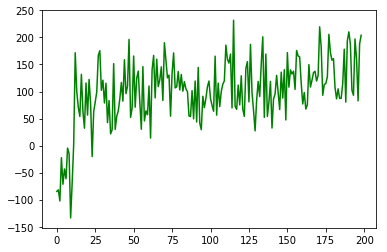

In [9]:
avg_reward_rec = np.delete(avg_reward_rec, 0, 0) #remove the first row which is garbage
fig2 = plt.figure()
plt.plot(avg_reward_rec,'g')

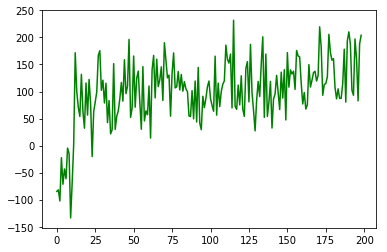

In [10]:
plt.plot(avg_reward_rec,'g')

In [11]:
avg_reward_rec

array([ -84.68029299,  -81.79404709, -102.35195517,  -22.37046157,
        -71.43121705,  -43.20980803,  -61.2322262 ,   -4.51168242,
        -14.65172509, -133.68942591,  -69.18121999,    2.85134532,
        171.69835447,   99.58601496,   70.52080504,   53.88429448,
        131.78143089,   63.31745327,   32.19608056,  115.79940702,
         56.46557399,  122.36478645,   77.08299163,  -20.23411733,
         62.77388152,   80.44491618,   99.49207716,  166.58755709,
        175.49847052,  102.24103794,  120.96109919,   78.8133099 ,
        115.28513133,   42.54273715,   83.26790217,   21.65852669,
         29.21742691,  151.60919766,   29.99872872,   54.20261183,
         64.38549586,   86.58399357,  116.76160902,   82.25199116,
        158.75493048,   96.09138483,  109.66305522,  196.32674494,
         52.15857838,   68.91202291,  165.67065755,   70.97765437,
        124.84454258,  137.74243719,   80.44052442,   30.26608425,
        146.15982735,   45.54394181,   64.21718574,   57.03566

In [12]:
# # Verifying learned Q-table over a year
# print('\nYear run test')
# ps, r, done, info = eno.reset()
# yr_test_record = np.empty(4)

# while True:
#     s = sarsa.discretize(ps)
#     a = sarsa.choose_greedy_action(s)
    
# #     print("\nBatt: ", eno.batt)
# #     print("Henergy: ", eno.henergy)
# #     print("Action: ", (a+1)/10*DMAX)

#     yr_test_record = np.vstack((yr_test_record, [ps[0],ps[2],r, a])) #record battery, henergy, reward and action
# #     print("**************")
# #     print("Batt: ", ps[0])
# #     print("Henergy: ", ps[2])
# #     print("Action: ", a)


#     ns, r, done, info = eno.step(a)
    
#     if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
#         terminal = True
#     else:
#         terminal = False
    
#     s_ = sarsa.discretize(ns)
#     a_ = sarsa.choose_action(s_)        
# #     transition = [s,a,r,s_,a_]

# #     sarsa.learn(transition,terminal)
#     if done:
#         print("End of Year")
#         break

#     ps = ns

# yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage

In [13]:
# yr_test_reward_rec = yr_test_record[:,2]
# yr_test_reward_rec = yr_test_reward_rec[yr_test_reward_rec != 0]

# day_test_reward_rec = day_test_record[:,2]
# day_test_reward_rec = day_test_reward_rec[day_test_reward_rec != 0]


# fig = plt.figure(figsize=(24,4))
# ax1 = fig.add_subplot(221)
# ax1.plot(yr_test_reward_rec)
# ax1.set_title("Year Run Reward")
# # ax1.set_ylim([-400,400])

# ax2 = fig.add_subplot(222)
# ax2.plot(yr_test_record[:,0],'r')
# ax2.set_title("Year Run Battery")
# # ax2.set_ylim([0,1])

# ax3 = fig.add_subplot(223)
# ax3.plot(day_test_reward_rec)
# ax3.set_title("Day Run Reward")
# # ax3.set_ylim([-400,400])

# ax4 = fig.add_subplot(224)
# ax4.plot(day_test_record[:,0],'r')
# ax4.set_title("Day Run Battery")
# # ax4.set_ylim([0,1])

# fig.tight_layout()

In [14]:
# TIME_AXIS = np.arange(0,eno.TIME_STEPS)
# for DAY in range(eno.NO_OF_DAYS):
#     START = DAY*24
#     END = START+24

#     fig = plt.figure(figsize=(16,4))
#     st = fig.suptitle("DAY %s" %(DAY))

#     ax2 = fig.add_subplot(131)
#     ax2.plot(yr_test_record[START:END,1],'g')
#     ax2.set_title("Harvested Energy")
#     plt.xlabel("Hour")
#     ax2.set_ylim([0,1.2])

#     #plot battery for year run
#     ax1 = fig.add_subplot(132)
#     ax1.plot(TIME_AXIS,yr_test_record[START:END,0],'r') 
#     ax1.plot(TIME_AXIS, np.ones(eno.TIME_STEPS)*eno.BOPT/eno.BMAX,'r--')
#     ax1.set_title("YEAR RUN")
#     if END < (eno.NO_OF_DAYS*eno.TIME_STEPS):
#         ax1.text(12, 0, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=11, ha='center')
#     plt.xlabel("Hour")
#     ax1.set_ylabel('Battery', color='r',fontsize=12)
#     ax1.set_ylim([0,1.2])

#     #plot actions for year run
#     ax1a = ax1.twinx()
#     ax1a.plot(yr_test_record[START:END,3])
#     ax1a.set_ylim([0,N_ACTIONS])
#     ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)

    
    
#     #plot battery for day run
#     ax3 = fig.add_subplot(133)
#     ax3.plot(TIME_AXIS,day_test_record[START:END,0],'r') 
#     ax3.plot(TIME_AXIS, np.ones(eno.TIME_STEPS)*eno.BOPT/eno.BMAX,'r--')
#     ax3.set_title("DAY RUN")
#     if END < (eno.NO_OF_DAYS*eno.TIME_STEPS):
#         ax3.text(12, 0, "REWARD = %.2f\n" %(day_test_record[END,2]),fontsize=11, ha='center')
#     plt.xlabel("Hour")
#     ax3.set_ylabel('Battery', color='r',fontsize=12)
#     ax3.set_ylim([0,1.2])
    
#     #plot actions for day run
#     ax3a = ax3.twinx()
#     ax3a.plot(day_test_record[START:END,3])
#     ax3a.set_ylim([0,N_ACTIONS])
#     ax3a.set_ylabel('Duty Cycle', color='b',fontsize=12)

#     fig.tight_layout()
#     st.set_y(0.95)
#     fig.subplots_adjust(top=0.75)
#     plt.show()